# *Developing Machine Learning Pipeline Proof of Concept with DataCo Supply Chain Dataset*

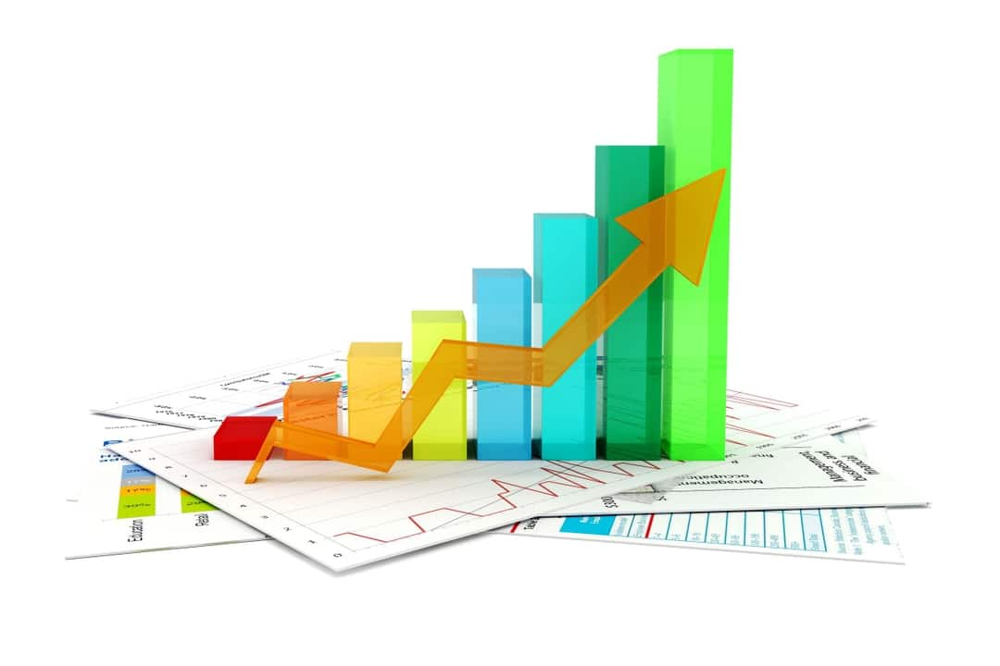

# Introduction

Welcome to this Proof of Concept development of Machine Learning pipeline on the DataCo Global Supply Chain Dataset. This research project objective is to gain insights into shipping operations performance over time reflected in the dataset and to build predictive model utilizing Machine Learning techniques to identify late shipment delivery in the future. This notebook has been carefully prepared that comprises of both the exploration stage to gather insights from the data as well as the model building and performance evaluation to forecast shipment delivery timeliness. Before diving deep into the technical analysis section, let's cleary define the research key question as a problem statement and research objectives as our approach for a solution:

***Main Question***: How to apply Machine Learning techniques to build a predictive model that can identify risks drivers of shipment delay, highlight the impact and summarize the causes to mitigate from the risks in future shipments within the operations of Data Co Supply Chain corporation? 

***Objective***: Research the applicability of ML solution to predict late shipment deliveries for Expeditors B.V. (EXPD) through develop Proof of Concept of public data. The to-be-developed tool needs to have the following capabilities:
-	Ability to extract from the 4-year records of completely delivered shipments for insights and relevant factors that can help with prediction for shipment delay
-	Ability to output the late delivery likelihood for each shipment
-	Ability to explain the reason for its prediction per case (e.g., list of correlated delay causes)

***About the DataCo Global Supply Chain Dataset:***
- Published on March 13th , 2019 collected by Mendeley Data organization
- Allows the use of ML algorithms for big data analytics to develop smart supply chain solution
- Areas of important registered activities of DataCo Global: Provisioning , Production , Sales, and Commercial Distribution.
- Products: Clothing , Sports, and Electronic Supplies
- Contains 180518 shipments, with 53 detailed columns
- Time range: January 2015 – January 2018

The training dataset package comes in the shape of 3 separate files:

DataCoSupplyChainDataset.csv: this is our main training data as described above.

DescriptionDataCoSupplyChain.csv: this contains a brief explanation of what each of the column in the training data means

tokenized_access_logs.csv: this is unstructured data represents ClickStream of users when making orders, which is not the focus of this research

In the ***first and second section***, I will first explore what does the dataset contain at face value, and then clean, transform and standardize the data to prepare for further analysis.

In the ***third and fourth section***, I will provide comprehensive Exploratory Data Analysis on the entire dataset. I shall be using Plotly(mostly) and Matplotlib, together with Klib to understand correlations among columns.

In the ***fifth section***, I will work on model building based on the actual data and understanding gathered from the analysis part and will attempt to apply a variety of different Machine Learning classification methods from the basics such as Logistics Regression and Nearest Neighbor to more advanced ones employing ensemble methods such as Bagging (Random Forest) and Boosting (XGBoost)

In the ***sixth section***, I will compare the effectiveness and perfomance of these ML methods and choose the best method for further fine-tuning.

# Table of Contents

[1. Meeting the Data](#section-one)

[2. Clean Data Manually](#section-two)
    
[3. EDA with Autoviz library](#section-three)

[4. EDA with Klib and Timeseries Data Analysis](#section-four)
   - [4.1 Statistical Distribution of key features values](#sectionfour-subone)
   - [4.2 Time Series Analysis on Shipping & Ordering Attributes](#sectionfour-subtwo) 
   - [4.3 Extracting Insights from Shipping Date](#sectionfour-subthree)
   - [4.4 Multivariate Correlation Analysis](#sectionfour-subfour)
    
[5. Training the Classification Models](#section-five)
   - [5.1 Logistics Regression Method](#sectionfive-subone)
   - [5.2 Decision Tree Classifier Method](#sectionfive-subtwo)
   - [5.3 Supported Vector Machine Method](#sectionfive-subthree)
   - [5.4 Decision Tree Classifier Method](#sectionfive-subfour)
   - [5.5 Random Forest Classifier Method](#sectionfive-subfive)
   - [5.6 Extreme Gradient Boosting Classifier Method](#sectionfive-subsix)
    
[6. ML Models Performance Comparison](#section-six)

In [1]:
# Importing neccesary packages

import numpy as np
import pandas as pd
from pandas import DataFrame, concat
pd.set_option('display.max_columns', 2000)

import warnings
warnings.filterwarnings("ignore")

#manual viz
import seaborn as sns
from matplotlib import pyplot as plt
plt.style.use('seaborn-bright')

# Import statements required for Plotly 
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
from plotly import tools
import plotly.express as px
import plotly.figure_factory as ff
from plotly.subplots import make_subplots

from datetime import datetime
import datetime as dt

In [2]:
# make sure to search for packages on all paths
import sys
import os
import site
sys.path.append(os.path.join(os.path.dirname(site.getsitepackages()[0]), "site-packages"))

<a id="section-one"></a>
# I/ Meeting the Data

In [3]:
# Loading the data
raw_data = pd.read_csv("Raw Data Kaggle\\DataCoSupplyChainDataset.csv", encoding='latin1')

In [4]:
# Checking the last five rows of this shipment delivery dataset
raw_data.tail()

,Type,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Delivery Status,Late_delivery_risk,Category Id,Category Name,Customer City,Customer Country,Customer Email,Customer Fname,Customer Id,Customer Lname,Customer Password,Customer Segment,Customer State,Customer Street,Customer Zipcode,Department Id,Department Name,Latitude,Longitude,Market,Order City,Order Country,Order Customer Id,order date (DateOrders),Order Id,Order Item Cardprod Id,Order Item Discount,Order Item Discount Rate,Order Item Id,Order Item Product Price,Order Item Profit Ratio,Order Item Quantity,Sales,Order Item Total,Order Profit Per Order,Order Region,Order State,Order Status,Order Zipcode,Product Card Id,Product Category Id,Product Description,Product Image,Product Name,Product Price,Product Status,shipping date (DateOrders),Shipping Mode
180514,CASH,4,4,40.000000,399.980011,Shipping on time,0,45,Fishing,Brooklyn,EE. UU.,XXXXXXXXX,Maria,1005,Peterson,XXXXXXXXX,Home Office,NY,1322 Broad Glade,11207.0,7,Fan Shop,40.640930,-73.942711,Pacific Asia,Shanghái,China,1005,1/16/2016 3:40,26043,1004,0.0,0.00,65177,399.980011,0.10,1,399.980011,399.980011,40.000000,Eastern Asia,Shanghái,CLOSED,NaN,1004,45,NaN,http://images.acmesports.sports/Field+%26+Stre...,Field & Stream Sportsman 16 Gun Fire Safe,399.980011,0,1/20/2016 3:40,Standard Class
180515,DEBIT,3,2,-613.770019,395.980011,Late delivery,1,45,Fishing,Bakersfield,EE. UU.,XXXXXXXXX,Ronald,9141,Clark,XXXXXXXXX,Corporate,CA,7330 Broad Apple Moor,93304.0,7,Fan Shop,35.362545,-119.018700,Pacific Asia,Hirakata,Japón,9141,1/16/2016 1:34,26037,1004,4.0,0.01,65161,399.980011,-1.55,1,399.980011,395.980011,-613.770019,Eastern Asia,Osaka,COMPLETE,NaN,1004,45,NaN,http://images.acmesports.sports/Field+%26+Stre...,Field & Stream Sportsman 16 Gun Fire Safe,399.980011,0,1/19/2016 1:34,Second Class
180516,TRANSFER,4,4,141.110001,391.980011,Late delivery,1,45,Fishing,Bristol,EE. UU.,XXXXXXXXX,John,291,Smith,XXXXXXXXX,Corporate,CT,97 Burning Landing,6010.0,7,Fan Shop,41.629959,-72.967155,Pacific Asia,Adelaide,Australia,291,1/15/2016 21:00,26024,1004,8.0,0.02,65129,399.980011,0.36,1,399.980011,391.980011,141.110001,Oceania,Australia del Sur,PENDING,NaN,1004,45,NaN,http://images.acmesports.sports/Field+%26+Stre...,Field & Stream Sportsman 16 Gun Fire Safe,399.980011,0,1/20/2016 21:00,Standard Class
180517,PAYMENT,5,4,186.229996,387.980011,Advance shipping,0,45,Fishing,Caguas,Puerto Rico,XXXXXXXXX,Mary,2813,Smith,XXXXXXXXX,Consumer,PR,2585 Silent Autumn Landing,725.0,7,Fan Shop,18.213350,-66.370575,Pacific Asia,Adelaide,Australia,2813,1/15/2016 20:18,26022,1004,12.0,0.03,65126,399.980011,0.48,1,399.980011,387.980011,186.229996,Oceania,Australia del Sur,PENDING_PAYMENT,NaN,1004,45,NaN,http://images.acmesports.sports/Field+%26+Stre...,Field & Stream Sportsman 16 Gun Fire Safe,399.980011,0,1/18/2016 20:18,Standard Class
180518,PAYMENT,3,4,168.949997,383.980011,Shipping on time,0,45,Fishing,Caguas,Puerto Rico,XXXXXXXXX,Andrea,7547,Ortega,XXXXXXXXX,Consumer,PR,697 Little Meadow,725.0,7,Fan Shop,18.290380,-66.370613,Pacific Asia,Nagercoil,India,7547,1/15/2016 18:54,26018,1004,16.0,0.04,65113,399.980011,0.44,1,399.980011,383.980011,168.949997,South Asia,Tamil Nadu,PENDING_PAYMENT,NaN,1004,45,NaN,http://images.acmesports.sports/Field+%26+Stre...,Field & Stream Sportsman 16 Gun Fire Safe,399.980011,0,1/19/2016 18:54,Standard Class


In [5]:
# Checking the shape
raw_data.shape

(180519, 53)

In [6]:
# Describing dataset
raw_data.describe()

,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Late_delivery_risk,Category Id,Customer Id,Customer Zipcode,Department Id,Latitude,Longitude,Order Customer Id,Order Id,Order Item Cardprod Id,Order Item Discount,Order Item Discount Rate,Order Item Id,Order Item Product Price,Order Item Profit Ratio,Order Item Quantity,Sales,Order Item Total,Order Profit Per Order,Order Zipcode,Product Card Id,Product Category Id,Product Description,Product Price,Product Status
count,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180516.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,24840.000000,180519.000000,180519.000000,0.0,180519.000000,180519.0
mean,3.557526,2.931847,21.974989,183.107609,0.548291,31.851451,6691.379495,35921.126914,5.443460,29.719955,-84.915675,6691.379495,36221.894903,692.509764,20.664741,0.101668,90260.000000,141.232550,0.120647,2.127638,203.772096,183.107609,21.974989,55426.132327,692.509764,31.851451,NaN,141.232550,0.0
std,1.619174,1.374449,104.433526,120.043670,0.497664,15.640064,4162.918106,37542.461122,1.629246,9.813646,21.433241,4162.918106,21045.379569,336.446807,21.800901,0.070415,52111.490959,139.732492,0.466796,1.453451,132.273077,120.043670,104.433526,31919.279101,336.446807,15.640064,NaN,139.732492,0.0
min,0.000000,0.000000,-4274.979980,7.490000,0.000000,2.000000,1.000000,603.000000,2.000000,-33.937553,-158.025986,1.000000,1.000000,19.000000,0.000000,0.000000,1.000000,9.990000,-2.750000,1.000000,9.990000,7.490000,-4274.979980,1040.000000,19.000000,2.000000,NaN,9.990000,0.0
25%,2.000000,2.000000,7.000000,104.379997,0.000000,18.000000,3258.500000,725.000000,4.000000,18.265432,-98.446312,3258.500000,18057.000000,403.000000,5.400000,0.040000,45130.500000,50.000000,0.080000,1.000000,119.980003,104.379997,7.000000,23464.000000,403.000000,18.000000,NaN,50.000000,0.0
50%,3.000000,4.000000,31.520000,163.990005,1.000000,29.000000,6457.000000,19380.000000,5.000000,33.144863,-76.847908,6457.000000,36140.000000,627.000000,14.000000,0.100000,90260.000000,59.990002,0.270000,1.000000,199.919998,163.990005,31.520000,59405.000000,627.000000,29.000000,NaN,59.990002,0.0
75%,5.000000,4.000000,64.800003,247.399994,1.000000,45.000000,9779.000000,78207.000000,7.000000,39.279617,-66.370583,9779.000000,54144.000000,1004.000000,29.990000,0.160000,135389.500000,199.990005,0.360000,3.000000,299.950012,247.399994,64.800003,90008.000000,1004.000000,45.000000,NaN,199.990005,0.0
max,7.000000,4.000000,911.799988,1939.989990,1.000000,76.000000,20757.000000,99205.000000,12.000000,48.781933,115.263077,20757.000000,77204.000000,1363.000000,500.000000,0.250000,180519.000000,1999.989990,0.500000,5.000000,1999.989990,1939.989990,911.799988,99301.000000,1363.000000,76.000000,NaN,1999.989990,0.0


<a id="section-two"></a>
# II/ Clean Data Manually

We would like to remove columns with the majority of which contain only blank fields (i.e. missing values) and also only keep certains columns that are relevant to this project analytical goal. We also exclude rows with Delivery Status as Shipping Canceled since these shipments do not take place in reality.

In [7]:
# drop all columns that contain more than 3000 NA values
max_number_of_nas = 3000
df = raw_data.loc[:, (raw_data.isnull().sum(axis=0) <= max_number_of_nas)]

# drop unnecessary columns and shipments with Shipping canceled status
df.drop(columns=['Benefit per order','Sales per customer','Late_delivery_risk','Category Id','Customer Email','Customer Fname','Customer Id','Customer Lname','Customer Password','Customer Segment','Customer Street','Customer Zipcode','Latitude','Longitude','Department Id','Order Customer Id','Order Item Cardprod Id','Order Item Discount','Order Item Discount Rate','Order Item Id','Order Item Product Price','Order Item Profit Ratio','Sales','Order Item Total','Order Profit Per Order','Product Card Id','Product Category Id','Product Image','Product Price','Product Status'], inplace=True)
df.drop(df[df['Delivery Status'] == "Shipping canceled"].index, inplace=True)

In [8]:
clean_data = df

In [9]:
clean_data.tail()

,Type,Days for shipping (real),Days for shipment (scheduled),Delivery Status,Category Name,Customer City,Customer Country,Customer State,Department Name,Market,Order City,Order Country,order date (DateOrders),Order Id,Order Item Quantity,Order Region,Order State,Order Status,Product Name,shipping date (DateOrders),Shipping Mode
180514,CASH,4,4,Shipping on time,Fishing,Brooklyn,EE. UU.,NY,Fan Shop,Pacific Asia,Shanghái,China,1/16/2016 3:40,26043,1,Eastern Asia,Shanghái,CLOSED,Field & Stream Sportsman 16 Gun Fire Safe,1/20/2016 3:40,Standard Class
180515,DEBIT,3,2,Late delivery,Fishing,Bakersfield,EE. UU.,CA,Fan Shop,Pacific Asia,Hirakata,Japón,1/16/2016 1:34,26037,1,Eastern Asia,Osaka,COMPLETE,Field & Stream Sportsman 16 Gun Fire Safe,1/19/2016 1:34,Second Class
180516,TRANSFER,4,4,Late delivery,Fishing,Bristol,EE. UU.,CT,Fan Shop,Pacific Asia,Adelaide,Australia,1/15/2016 21:00,26024,1,Oceania,Australia del Sur,PENDING,Field & Stream Sportsman 16 Gun Fire Safe,1/20/2016 21:00,Standard Class
180517,PAYMENT,5,4,Advance shipping,Fishing,Caguas,Puerto Rico,PR,Fan Shop,Pacific Asia,Adelaide,Australia,1/15/2016 20:18,26022,1,Oceania,Australia del Sur,PENDING_PAYMENT,Field & Stream Sportsman 16 Gun Fire Safe,1/18/2016 20:18,Standard Class
180518,PAYMENT,3,4,Shipping on time,Fishing,Caguas,Puerto Rico,PR,Fan Shop,Pacific Asia,Nagercoil,India,1/15/2016 18:54,26018,1,South Asia,Tamil Nadu,PENDING_PAYMENT,Field & Stream Sportsman 16 Gun Fire Safe,1/19/2016 18:54,Standard Class


In [10]:
clean_data.describe()

,Days for shipping (real),Days for shipment (scheduled),Order Id,Order Item Quantity
count,172765.000000,172765.000000,172765.000000,172765.000000
mean,3.557700,2.933100,36215.167210,2.127694
std,1.618259,1.373405,21036.193887,1.453663
min,0.000000,0.000000,1.000000,1.000000
25%,2.000000,2.000000,18069.000000,1.000000
50%,3.000000,4.000000,36126.000000,1.000000
75%,5.000000,4.000000,54111.000000,3.000000
max,7.000000,4.000000,77204.000000,5.000000


In [11]:
clean_data.shape

(172765, 21)

In [12]:
#replace Late delivery status as Late dispatch status for clarity
clean_data.replace("Late delivery","Late Dispatch", inplace=True)

In [13]:
#defining delivery timeliness per shipment
def Late_ontime_shipment(row):
    scheduled_delivery = row['Days for shipment (scheduled)']
    actual_delivery = row['Days for shipping (real)']
    
    if scheduled_delivery >= actual_delivery:
        delivery_timeliness = 1 #Ontime
    else:
        delivery_timeliness = 0 #Late
    return delivery_timeliness

In [14]:
clean_data['Delivery Timeliness'] = clean_data.apply(Late_ontime_shipment,axis=1)

In [15]:
#replacing special characters
special_characters = {'á': 'a', 'Á': 'A', 'í': 'i', 'é': 'e', 'ú': 'u', 'ñ': 'n', 'ó': 'o'}
clean_data.replace(special_characters, regex=True, inplace=True)

In [16]:
#Replacing the Customer Country for USA
clean_data['Customer Country'] = clean_data['Customer Country'].str.replace('EE. UU.', 'U.S.A')

#adding Origin-Destination country pair per shipment
clean_data['Origin Destination Country'] = clean_data.agg(lambda x: f"{x['Order Country']} to {x['Customer Country']}", axis=1)

In [17]:
clean_data.astype({'Customer Country': 'string','Origin Destination Country':'string'}).dtypes

Type                             object
Days for shipping (real)          int64
Days for shipment (scheduled)     int64
Delivery Status                  object
Category Name                    object
Customer City                    object
Customer Country                 string
Customer State                   object
Department Name                  object
Market                           object
Order City                       object
Order Country                    object
order date (DateOrders)          object
Order Id                          int64
Order Item Quantity               int64
Order Region                     object
Order State                      object
Order Status                     object
Product Name                     object
shipping date (DateOrders)       object
Shipping Mode                    object
Delivery Timeliness               int64
Origin Destination Country       string
dtype: object

In [18]:
clean_data.tail()

,Type,Days for shipping (real),Days for shipment (scheduled),Delivery Status,Category Name,Customer City,Customer Country,Customer State,Department Name,Market,Order City,Order Country,order date (DateOrders),Order Id,Order Item Quantity,Order Region,Order State,Order Status,Product Name,shipping date (DateOrders),Shipping Mode,Delivery Timeliness,Origin Destination Country
180514,CASH,4,4,Shipping on time,Fishing,Brooklyn,U.S.A,NY,Fan Shop,Pacific Asia,Shanghai,China,1/16/2016 3:40,26043,1,Eastern Asia,Shanghai,CLOSED,Field & Stream Sportsman 16 Gun Fire Safe,1/20/2016 3:40,Standard Class,1,China to U.S.A
180515,DEBIT,3,2,Late Dispatch,Fishing,Bakersfield,U.S.A,CA,Fan Shop,Pacific Asia,Hirakata,Japon,1/16/2016 1:34,26037,1,Eastern Asia,Osaka,COMPLETE,Field & Stream Sportsman 16 Gun Fire Safe,1/19/2016 1:34,Second Class,0,Japon to U.S.A
180516,TRANSFER,4,4,Late Dispatch,Fishing,Bristol,U.S.A,CT,Fan Shop,Pacific Asia,Adelaide,Australia,1/15/2016 21:00,26024,1,Oceania,Australia del Sur,PENDING,Field & Stream Sportsman 16 Gun Fire Safe,1/20/2016 21:00,Standard Class,1,Australia to U.S.A
180517,PAYMENT,5,4,Advance shipping,Fishing,Caguas,Puerto Rico,PR,Fan Shop,Pacific Asia,Adelaide,Australia,1/15/2016 20:18,26022,1,Oceania,Australia del Sur,PENDING_PAYMENT,Field & Stream Sportsman 16 Gun Fire Safe,1/18/2016 20:18,Standard Class,0,Australia to Puerto Rico
180518,PAYMENT,3,4,Shipping on time,Fishing,Caguas,Puerto Rico,PR,Fan Shop,Pacific Asia,Nagercoil,India,1/15/2016 18:54,26018,1,South Asia,Tamil Nadu,PENDING_PAYMENT,Field & Stream Sportsman 16 Gun Fire Safe,1/19/2016 18:54,Standard Class,1,India to Puerto Rico


In [19]:
clean_data.to_csv("Clean Data Kaggle\\clean_data.csv")

From the clean dataset above, we can categorize the columns into the following groups:
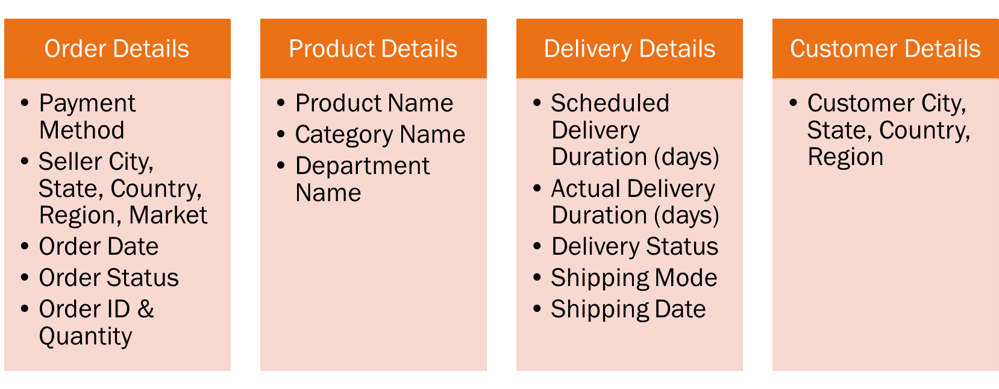

<a id="section-three"></a>
# III/ EDA with Autoviz library

You should consider upgrading via the 'C:\Users\duong\AppData\Local\Programs\Python\Python38\python.exe -m pip install --upgrade pip' command.


Alert! from version 0.1.39, fter importing, you must do '%matplotlib inline' to display charts in Jupyter Notebooks.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not display plots but saves them in AutoViz_Plots folder in local machine.
Updated: chart_format='bokeh' generates and displays charts in your local Jupyter notebook.
      chart_format='server' generates and displays charts in the browser - one tab for each chart.
      chart_format='html' silently saves charts HTML format - they are also interactive!


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
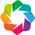

In [20]:
#importing Autoviz class
#autoviz tool for EDA
!pip3 install Autoviz
from autoviz.AutoViz_Class import AutoViz_Class#Instantiate the AutoViz class
%matplotlib inline
AV = AutoViz_Class()

In [21]:
df = AV.AutoViz("C:/Users/ams-duongn.EXPEDITORS/Desktop/learn/shipment_delay_classification/Clean Data Kaggle/clean_data.csv", depVar="Delivery Timeliness")

    pandas ascii encoder does not work for this file. Continuing...
    pandas utf-8 encoder does not work for this file. Continuing...
    pandas iso-8859-1 encoder does not work for this file. Continuing...
    pandas cp1252 encoder does not work for this file. Continuing...
    pandas latin1 encoder does not work for this file. Continuing...
Not able to read or load file. Please check your inputs and try again...


***Key Observations***

* Shipment Factors: from the following 2 charts we can conclude that Delivery Status and Shipping Mode greatly determines order timeliness (0 = Late and 1 = On Time)
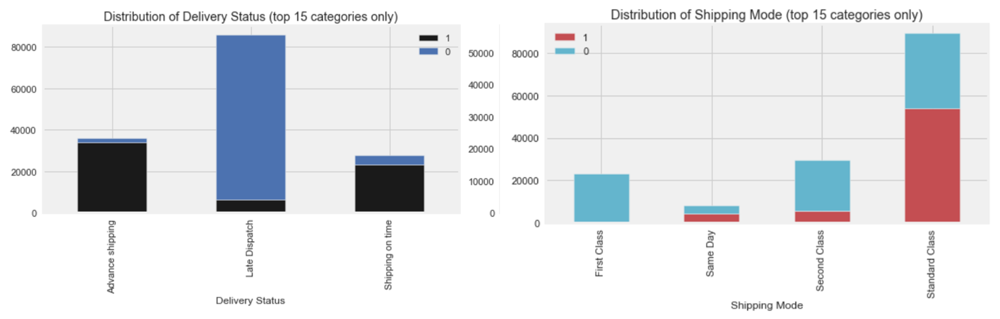

<a id="section-four"></a>
# IV/ EDA with Klib and Timeseries Data Analysis

In [22]:
!pip3 install klib --user

You should consider upgrading via the 'C:\Users\duong\AppData\Local\Programs\Python\Python38\python.exe -m pip install --upgrade pip' command.


<a id="sectionfour-subone"></a>
## 4.1 Statistical Distribution of key features values

### Distribution plot of Days for shipment (scheduled) variable

Large dataset detected, using 10000 random samples for the plots. Summary statistics are still based on the entire dataset.


<AxesSubplot:xlabel='Days for shipment (scheduled)', ylabel='Density'>

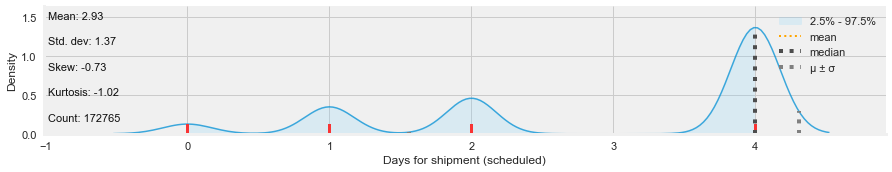

In [23]:
import klib
klib.dist_plot(clean_data['Days for shipment (scheduled)'])

***Key Observations***

* The distribution shows most shipments are scheduled to be delievered in 4 days

### Distribution plot of Days for shipping (real) variable

Large dataset detected, using 10000 random samples for the plots. Summary statistics are still based on the entire dataset.


<AxesSubplot:xlabel='Days for shipping (real)', ylabel='Density'>

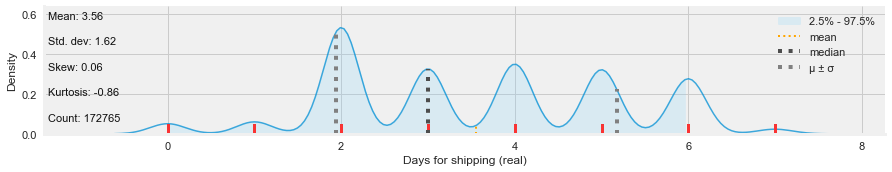

In [24]:
klib.dist_plot(clean_data['Days for shipping (real)'])

***Key Observations***

* The distribution shows in reality the majority of shipments were delievered in 2 days while 3-6 days deliveries accounts for similar portion.

<a id="sectionfour-subtwo"></a>
## 4.2 Time Series Analysis on Shipping & Ordering Attributes

### Histogram with Parato Plot
This section shows pareto analysis on the Actual Shipping Duration in Days

In [25]:
#create a new DataFrame for Histogram plot by grouping the Actual Shipping Duration
histogram_data_actual = (clean_data.groupby("Days for shipping (real)")["Order Id"].count().reset_index())
histogram_data_actual.rename(columns={"Order Id":"Count of Shipments"}, inplace=True)
histogram_data_actual["Days for shipping (real)"] = histogram_data_actual["Days for shipping (real)"].apply(lambda x: str(x) + " days")
histogram_data_actual.set_index("Days for shipping (real)", inplace=True)

#sort DataFrame by count descending
histogram_data_actual = histogram_data_actual.sort_values(by='Count of Shipments', ascending=False)

#add coulumn to display cumulative percentage
histogram_data_actual["Cumulative Percent Of Total Shipment Counts"] = histogram_data_actual["Count of Shipments"].cumsum() / histogram_data_actual["Count of Shipments"].sum()*100
histogram_data_actual

,Count of Shipments,Cumulative Percent Of Total Shipment Counts
Days for shipping (real),,
2 days,48348,27.984835
4 days,31877,46.435910
3 days,28751,63.077591
5 days,27666,79.091251
6 days,24283,93.146760
1 days,4999,96.040286
0 days,4675,98.746274
7 days,2166,100.000000


In [26]:
# Create figure with secondary y-axis
fig = make_subplots(specs=[[{"secondary_y": True}]])

# Add traces
fig.add_trace(
    go.Bar(
        x=histogram_data_actual.index,
        y=histogram_data_actual["Count of Shipments"],
        name="Number of Instances",
    ),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(
        x=histogram_data_actual.index,
        y=histogram_data_actual["Cumulative Percent Of Total Shipment Counts"],
        name="Percent of Instances",
    ),
    secondary_y=True,
)

# Add figure title
fig.update_layout(title_text="Histogram with Pareto for Actual Shipping Duration in Days")

# Set x-axis title
fig.update_xaxes(title_text="Actual Shipping Duration (days)")

# Set y-axes titles
fig.update_yaxes(title_text="Number of Instances", secondary_y=False)
fig.update_yaxes(title_text="Percent of Instances" , secondary_y=True)

fig.show()

In [27]:
#plot.figure.savefig('figure.pdf')
#to save the plots above into pdf file

This section shows pareto analysis on the Scheduled Shipping Duration in Days

In [28]:
#create a new DataFrame for Histogram plot by grouping the Actual Shipping Duration
histogram_data_scheduled = (clean_data.groupby("Days for shipment (scheduled)")["Order Id"].count().reset_index())
histogram_data_scheduled.rename(columns={"Order Id":"Count of Shipments"}, inplace=True)
histogram_data_scheduled["Days for shipment (scheduled)"] = histogram_data_scheduled["Days for shipment (scheduled)"].apply(lambda x: str(x) + " days")
histogram_data_scheduled.set_index("Days for shipment (scheduled)", inplace=True)

#sort DataFrame by count descending
histogram_data_scheduled = histogram_data_scheduled.sort_values(by='Count of Shipments', ascending=False)

#add coulumn to display cumulative percentage
histogram_data_scheduled["Cumulative Percent Of Total Shipment Counts"] = histogram_data_scheduled["Count of Shipments"].cumsum() / histogram_data_scheduled["Count of Shipments"].sum()*100
histogram_data_scheduled

,Count of Shipments,Cumulative Percent Of Total Shipment Counts
Days for shipment (scheduled),,
4 days,103153,59.707117
2 days,33806,79.274737
1 days,26513,94.621017
0 days,9293,100.000000


In [29]:
# Create figure with secondary y-axis
fig = make_subplots(specs=[[{"secondary_y": True}]])

# Add traces
fig.add_trace(
    go.Bar(
        x=histogram_data_scheduled.index,
        y=histogram_data_scheduled["Count of Shipments"],
        name="Number of Instances",
    ),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(
        x=histogram_data_scheduled.index,
        y=histogram_data_scheduled["Cumulative Percent Of Total Shipment Counts"],
        name="Percent of Instances",
    ),
    secondary_y=True,
)

# Add figure title
fig.update_layout(title_text="Histogram with Pareto for Scheduled Shipping Duration in Days")

# Set x-axis title
fig.update_xaxes(title_text="Scheduled Shipping Duration (days)")

# Set y-axes titles
fig.update_yaxes(title_text="Number of Instances", secondary_y=False)
fig.update_yaxes(title_text="Percent of Instances" , secondary_y=True)

fig.show()

***Key Observations***

* From the Delivery Duration Histograms above, we can conclude that 80% of shipments are scheduled to be delivered in 4 days (60%) and 2 days (20%), while in reality 30% of these are delivered in 2 days and 32% are delivered over 4 days (late)

### Distribution plot of Days Difference between Shipping and Order Dates

In [30]:
# cast date-columns from current object datatype to datetime datatype
clean_data['shipping date (DateOrders)'] = pd.to_datetime(clean_data['shipping date (DateOrders)'], utc=True, infer_datetime_format=True)
clean_data['order date (DateOrders)'] = pd.to_datetime(clean_data['order date (DateOrders)'],utc=True, infer_datetime_format=True)

In [31]:
# set the date as index and sort by index
#clean_data_date_index = clean_data.set_index('shipping date (DateOrders)').sort_index()
#clean_data_date_index.tail()

In [32]:
#Calculate difference in days between Shipping Date and Order Date
clean_data['Days Difference between Shipping and Order Dates'] = (clean_data['shipping date (DateOrders)'] - clean_data['order date (DateOrders)']).dt.days
clean_data.drop('order date (DateOrders)', axis='columns', inplace=True)

Large dataset detected, using 10000 random samples for the plots. Summary statistics are still based on the entire dataset.


<AxesSubplot:xlabel='Days Difference between Shipping and Order Dates', ylabel='Density'>

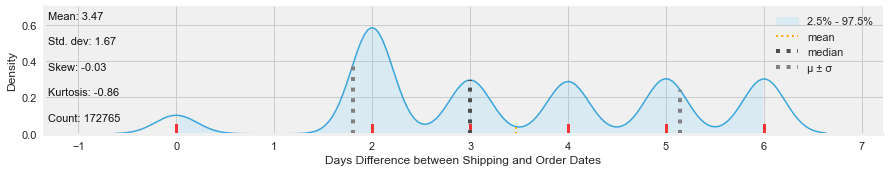

In [33]:
klib.dist_plot(clean_data['Days Difference between Shipping and Order Dates'])

***Key Observations***

* The distribution shows there is normally a lead time of 2 days between the Order and Shipping Out Date

### Aggregate Shipment Counts over Shipping Date
We plot the aggregate time series over shipment counts in this dataset. This is an interactive plot and you can use the usual plotly tools (upper right corner) to zoom, pan, and scale the view.

In [34]:
#pivoting the dataframe to aggregate the details by Total and Eligible participants from the title column accross all other columns
clean_data['Shipping Date Only'] = pd.to_datetime(clean_data['shipping date (DateOrders)']).dt.date
df_pivot = clean_data.pivot_table(index=['Shipping Date Only','Shipping Mode'], values=['Order Id'], aggfunc=np.count_nonzero).reset_index()

# fix the header of the pivoted dataframe
df_pivot.columns = [''.join(col).strip() for col in df_pivot.columns.values]
df_pivot.columns = df_pivot.columns.str.replace('Order Id','Shipment Counts')
df_pivot.head()

,Shipping Date Only,Shipping Mode,Shipment Counts
0,2015-01-03,First Class,23
1,2015-01-03,Same Day,3
2,2015-01-03,Second Class,6
3,2015-01-03,Standard Class,20
4,2015-01-04,First Class,7


In [35]:
fig1 = px.area(df_pivot
              ,x="Shipping Date Only"
              ,y="Shipment Counts"
              ,title='Shipment Count Distribution over 4 years'
              ,color="Shipping Mode"
              ,color_discrete_sequence=px.colors.qualitative.G10)
fig1.show()

***Key Observations***

* The partition of shipments delivered with different Shipping Mode seems to stay the same over time
* There was a 50% drop in shipment volume happened in October 2017
* Shipment volume fluctuates quite widely around the means but no clear seasonality factor

### Categorical Data Types Analysis
This section shows an example of categorical data visualization. The function allows to display the top and/or bottom values regarding their frequency in each column. Further, it gives an idea of the distribution of the values in the dataset. This plot comes in very handy during data analysis when considering changing datatypes to “category” or when planning to combine less frequent values into a seperate category before applying one-hot-encoding or similar functions.

In [36]:
def cardinality_pareto(dataframe, column):
    temp = dataframe[column].value_counts().reset_index()
    temp["PercentOfTotal"] = temp[column] / temp[column].sum()
    temp["PercentRunningTotal"] = temp["PercentOfTotal"].cumsum()
    temp = temp.sort_values(by='PercentOfTotal', ascending=False)
    return temp.head()

categorical_data = clean_data.select_dtypes(include='object')

# Yields a tuple of column name and series for each column in the dataframe
for column in categorical_data:
    print('Cardinality Pareto Analysis for : ', column)
    print(cardinality_pareto(categorical_data, column), end='\n\n')

Cardinality Pareto Analysis for :  Type
      index   Type  PercentOfTotal  PercentRunningTotal
0     DEBIT  69295        0.401094             0.401094
1  TRANSFER  42129        0.243851             0.644945
2   PAYMENT  41725        0.241513             0.886458
3      CASH  19616        0.113542             1.000000

Cardinality Pareto Analysis for :  Delivery Status
              index  Delivery Status  PercentOfTotal  PercentRunningTotal
0     Late Dispatch            98977        0.572900             0.572900
1  Advance shipping            41592        0.240743             0.813643
2  Shipping on time            32196        0.186357             1.000000

Cardinality Pareto Analysis for :  Category Name
                  index  Category Name  PercentOfTotal  PercentRunningTotal
0                Cleats          23514        0.136104             0.136104
1        Men's Footwear          21263        0.123075             0.259179
2       Women's Apparel          20116        0.116436

### Shipment Counts Distribution across Markets, Departments and Categories

In [37]:
# Plotting Shipment Counts Distribution across Markets, Departments and Categories

df = clean_data.groupby(["Market", "Department Name", "Category Name"])["Order Id"].agg(["nunique"]).rename(columns={"nunique":"Distinct Shipment Count"})
df.reset_index(inplace=True)

# plots with plotly
fig2 = px.treemap(df, path=[px.Constant("World"), "Market", "Department Name", "Category Name"], values='Distinct Shipment Count',
                  color='Distinct Shipment Count',hover_data=['Distinct Shipment Count'], color_continuous_scale='RdBu', title = "Shipment Counts Distribution across Markets, Departments and Categories")
fig2.update_layout(margin = dict(t=50, l=25, r=25, b=25))

print(df)
fig2.show()

     Market Department Name       Category Name  Distinct Shipment Count
0    Africa         Apparel              Cleats                     1319
1    Africa         Apparel      Men's Footwear                     1195
2    Africa        Fan Shop    Camping & Hiking                      763
3    Africa        Fan Shop             Fishing                      988
4    Africa        Fan Shop  Hunting & Shooting                       25
..      ...             ...                 ...                      ...
162    USCA        Outdoors        Golf Apparel                       56
163    USCA        Outdoors          Golf Balls                      231
164    USCA        Outdoors         Golf Gloves                      141
165    USCA        Outdoors          Golf Shoes                       60
166    USCA        Outdoors            Trade-In                      146

[167 rows x 4 columns]


***Key Observations:***

* Shipments’ customers reside in the USA and Puerto Rico
* Majority of sellers operate in LATAM and Europe market
* Transported goods are foremost Sports and Apparel products

<a id="sectionfour-subthree"></a>
## 4.3 Extracting insights from the Shipping Date

### Year/Month/Weekdays Insights
 
Let's so some data wrangling to produce sales distribution insights across year, month and weekdays:

In [38]:
#Preparing the correlations analysis by splitting Shipping date into Day, Month and Year value
import calendar
clean_data['Shipping Day'] = clean_data['shipping date (DateOrders)'].dt.day
clean_data['Shipping WeekDay Numeric'] = clean_data['shipping date (DateOrders)'].dt.weekday
clean_data['Shipping WeekDay'] = clean_data['shipping date (DateOrders)'].dt.weekday.apply(lambda x: calendar.day_name[x])
clean_data['Shipping Week'] = clean_data['shipping date (DateOrders)'].dt.isocalendar().week
clean_data['Shipping Month Numeric'] = clean_data['shipping date (DateOrders)'].dt.month
clean_data['Shipping Month'] = clean_data['shipping date (DateOrders)'].dt.month.apply(lambda x: calendar.month_abbr[x])
clean_data['Shipping Year'] = clean_data['shipping date (DateOrders)'].dt.year
clean_data.drop(['shipping date (DateOrders)','Shipping Date Only'], axis='columns', inplace=True)
clean_data.tail()

,Type,Days for shipping (real),Days for shipment (scheduled),Delivery Status,Category Name,Customer City,Customer Country,Customer State,Department Name,Market,Order City,Order Country,Order Id,Order Item Quantity,Order Region,Order State,Order Status,Product Name,Shipping Mode,Delivery Timeliness,Origin Destination Country,Days Difference between Shipping and Order Dates,Shipping Day,Shipping WeekDay Numeric,Shipping WeekDay,Shipping Week,Shipping Month Numeric,Shipping Month,Shipping Year
180514,CASH,4,4,Shipping on time,Fishing,Brooklyn,U.S.A,NY,Fan Shop,Pacific Asia,Shanghai,China,26043,1,Eastern Asia,Shanghai,CLOSED,Field & Stream Sportsman 16 Gun Fire Safe,Standard Class,1,China to U.S.A,4,20,2,Wednesday,3,1,Jan,2016
180515,DEBIT,3,2,Late Dispatch,Fishing,Bakersfield,U.S.A,CA,Fan Shop,Pacific Asia,Hirakata,Japon,26037,1,Eastern Asia,Osaka,COMPLETE,Field & Stream Sportsman 16 Gun Fire Safe,Second Class,0,Japon to U.S.A,3,19,1,Tuesday,3,1,Jan,2016
180516,TRANSFER,4,4,Late Dispatch,Fishing,Bristol,U.S.A,CT,Fan Shop,Pacific Asia,Adelaide,Australia,26024,1,Oceania,Australia del Sur,PENDING,Field & Stream Sportsman 16 Gun Fire Safe,Standard Class,1,Australia to U.S.A,5,20,2,Wednesday,3,1,Jan,2016
180517,PAYMENT,5,4,Advance shipping,Fishing,Caguas,Puerto Rico,PR,Fan Shop,Pacific Asia,Adelaide,Australia,26022,1,Oceania,Australia del Sur,PENDING_PAYMENT,Field & Stream Sportsman 16 Gun Fire Safe,Standard Class,0,Australia to Puerto Rico,3,18,0,Monday,3,1,Jan,2016
180518,PAYMENT,3,4,Shipping on time,Fishing,Caguas,Puerto Rico,PR,Fan Shop,Pacific Asia,Nagercoil,India,26018,1,South Asia,Tamil Nadu,PENDING_PAYMENT,Field & Stream Sportsman 16 Gun Fire Safe,Standard Class,1,India to Puerto Rico,4,19,1,Tuesday,3,1,Jan,2016


### Weekdays Insights

In [39]:
# Weekday Shipment Counts Distribution
df = clean_data.groupby(["Shipping WeekDay", "Shipping WeekDay Numeric", "Shipping Mode"])["Order Id"].agg(["nunique"]).rename(columns={"nunique":"Distinct Shipment Count"}).sort_values(by=['Shipping WeekDay Numeric'])
df.reset_index(inplace=True)
df.drop(columns=['Shipping WeekDay Numeric'], inplace=True)

# Colored Horizontal Bar Chart for Weekday Shipment Counts Distribution with granularity of Shipping Mode
weekdays = ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']

fig3 = go.Figure()
fig3.add_trace(go.Bar(
    y=weekdays,
    x=df[df["Shipping Mode"] == 'Same Day']['Distinct Shipment Count'],
    name='Same Day',
    orientation='h',
    marker=dict(
        color='rgba(246, 78, 139, 0.6)',
        line=dict(color='rgba(246, 78, 139, 1.0)', width=3)
    )
))
fig3.add_trace(go.Bar(
    y=weekdays,
    x=df[df["Shipping Mode"] == 'First Class']['Distinct Shipment Count'],
    name='First Class',
    orientation='h',
    marker=dict(
        color='rgba(58, 71, 80, 0.6)',
        line=dict(color='rgba(58, 71, 80, 1.0)', width=3)
    )
))
fig3.add_trace(go.Bar(
    y=weekdays,
    x=df[df["Shipping Mode"] == 'Second Class']['Distinct Shipment Count'],
    name='Second Class',
    orientation='h',
    marker=dict(
        color='rgba(71, 58, 131, 0.6)',
        line=dict(color='rgba(71, 58, 131, 1.0)', width=3)
    )
))
fig3.add_trace(go.Bar(
    y=weekdays,
    x=df[df["Shipping Mode"] == 'Standard Class']['Distinct Shipment Count'],
    name='Standard Class',
    orientation='h',
    marker=dict(
        color='rgb(50, 171, 96, 0.6)',
        line=dict(color='rgb(50, 171, 96, 1.0)', width=3)
    )
))

fig3.update_layout(title_text="Weekday Shipment Counts Distribution",barmode='stack')
fig3.show()

### Month-wise Insights

In [40]:
# Monthly Shipment Counts Distribution
df = clean_data.groupby(["Shipping Year","Shipping Month", "Shipping Month Numeric"])["Order Id"].agg(["nunique"]).rename(columns={"nunique":"Distinct Shipment Count"}).sort_values(by=["Shipping Year","Shipping Month Numeric"])
df.reset_index(inplace=True)
df.drop(columns=['Shipping Month Numeric'], inplace=True)

# Bar Plot with plotly.express

fig = px.bar(df, x="Shipping Year", y="Distinct Shipment Count", color="Shipping Month", text="Distinct Shipment Count", title="Annual Shipment Counts bifurcated by months")

fig.update_traces(texttemplate='%{text:.2s}', textposition='auto')
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide', xaxis={'tickformat':'d'})
fig.show()

***Key Observations:***

* There is slight fluctuation on shipment count per weekday, and more shipments shipped with Second Class on Saturday and First Class on Tuesday
* Overall weekday and shipping mode are stable factors over time
* Volume slightly dips in Jan and Feb, and there was 300 shipments increased per month in Oct – Dec 2017 over the baseline of 1700 shipments/month

<a id="sectionfour-subfour"></a>
## 4.4 Multivariate Correlation Analysis

### Categorical Data Transformation for Correlation Analysis

In [41]:
#Catgorical Data Encoding to seperate whether a shipment contains a certain feature or not.
delivery_status_encoding = pd.get_dummies(clean_data['Delivery Status'], prefix='Delivery_Status')
market_encoding = pd.get_dummies(clean_data['Market'], prefix='Market')
order_status_encoding = pd.get_dummies(clean_data['Order Status'], prefix='Order_Status')
shipping_mode_encoding = pd.get_dummies(clean_data['Shipping Mode'], prefix='Shipping_Mode')
origin_destination_country_encoding = pd.get_dummies(clean_data['Origin Destination Country'], prefix='Origin_Destination_Country')
clean_data_encoding = pd.concat([clean_data,delivery_status_encoding,market_encoding,order_status_encoding,shipping_mode_encoding], axis=1)
pair_wise_encoding = pd.concat([clean_data,origin_destination_country_encoding], axis=1)

In [42]:
clean_data_encoding.tail()

,Type,Days for shipping (real),Days for shipment (scheduled),Delivery Status,Category Name,Customer City,Customer Country,Customer State,Department Name,Market,Order City,Order Country,Order Id,Order Item Quantity,Order Region,Order State,Order Status,Product Name,Shipping Mode,Delivery Timeliness,Origin Destination Country,Days Difference between Shipping and Order Dates,Shipping Day,Shipping WeekDay Numeric,Shipping WeekDay,Shipping Week,Shipping Month Numeric,Shipping Month,Shipping Year,Delivery_Status_Advance shipping,Delivery_Status_Late Dispatch,Delivery_Status_Shipping on time,Market_Africa,Market_Europe,Market_LATAM,Market_Pacific Asia,Market_USCA,Order_Status_CLOSED,Order_Status_COMPLETE,Order_Status_ON_HOLD,Order_Status_PAYMENT_REVIEW,Order_Status_PENDING,Order_Status_PENDING_PAYMENT,Order_Status_PROCESSING,Shipping_Mode_First Class,Shipping_Mode_Same Day,Shipping_Mode_Second Class,Shipping_Mode_Standard Class
180514,CASH,4,4,Shipping on time,Fishing,Brooklyn,U.S.A,NY,Fan Shop,Pacific Asia,Shanghai,China,26043,1,Eastern Asia,Shanghai,CLOSED,Field & Stream Sportsman 16 Gun Fire Safe,Standard Class,1,China to U.S.A,4,20,2,Wednesday,3,1,Jan,2016,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1
180515,DEBIT,3,2,Late Dispatch,Fishing,Bakersfield,U.S.A,CA,Fan Shop,Pacific Asia,Hirakata,Japon,26037,1,Eastern Asia,Osaka,COMPLETE,Field & Stream Sportsman 16 Gun Fire Safe,Second Class,0,Japon to U.S.A,3,19,1,Tuesday,3,1,Jan,2016,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0
180516,TRANSFER,4,4,Late Dispatch,Fishing,Bristol,U.S.A,CT,Fan Shop,Pacific Asia,Adelaide,Australia,26024,1,Oceania,Australia del Sur,PENDING,Field & Stream Sportsman 16 Gun Fire Safe,Standard Class,1,Australia to U.S.A,5,20,2,Wednesday,3,1,Jan,2016,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1
180517,PAYMENT,5,4,Advance shipping,Fishing,Caguas,Puerto Rico,PR,Fan Shop,Pacific Asia,Adelaide,Australia,26022,1,Oceania,Australia del Sur,PENDING_PAYMENT,Field & Stream Sportsman 16 Gun Fire Safe,Standard Class,0,Australia to Puerto Rico,3,18,0,Monday,3,1,Jan,2016,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1
180518,PAYMENT,3,4,Shipping on time,Fishing,Caguas,Puerto Rico,PR,Fan Shop,Pacific Asia,Nagercoil,India,26018,1,South Asia,Tamil Nadu,PENDING_PAYMENT,Field & Stream Sportsman 16 Gun Fire Safe,Standard Class,1,India to Puerto Rico,4,19,1,Tuesday,3,1,Jan,2016,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1


### Correlation Plot

Here, we can examine the intercorrelation amongst the features.

### Display data with high correlations (both positive and negative)

Displaying absolute correlations above the threshold (0.35). Specify a positive "threshold" to limit the results further.


<AxesSubplot:title={'center':'Feature-correlation (pearson)'}>

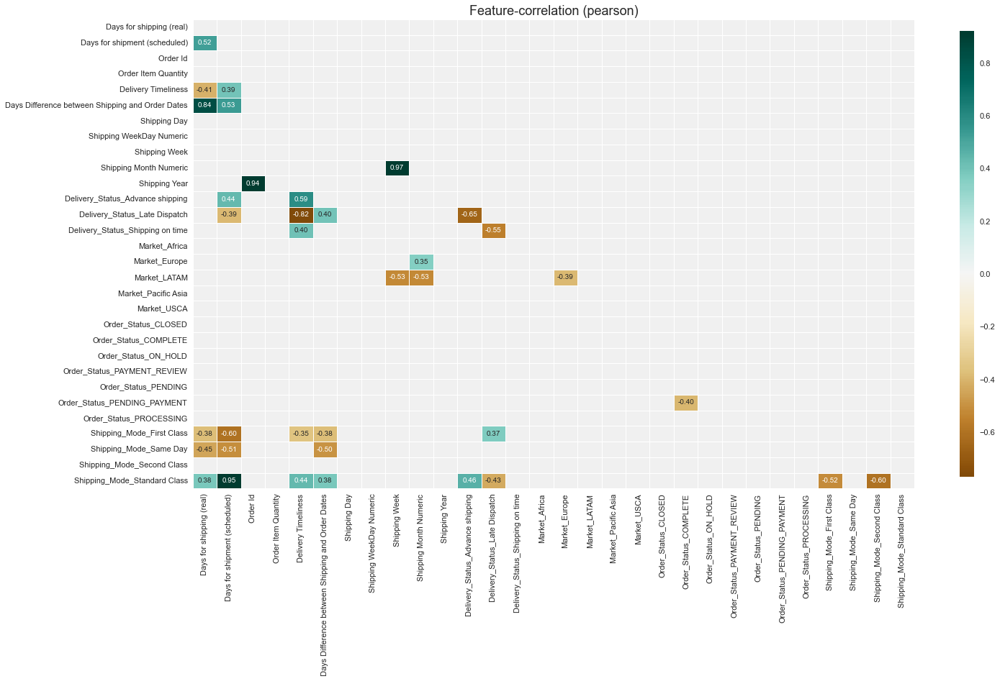

In [43]:
klib.corr_plot(clean_data_encoding, annot=True, split='high', threshold=0.35, figsize=(20,12))

***Key Observations***

* The correlation indices show there are inherent relationships among features, which means we need to be careful of data leakage during ML model training and needs to perform feature selection

### Correlation Data Matrix

In [44]:
klib.corr_mat(clean_data_encoding)

,Days for shipping (real),Days for shipment (scheduled),Order Id,Order Item Quantity,Delivery Timeliness,Days Difference between Shipping and Order Dates,Shipping Day,Shipping WeekDay Numeric,Shipping Week,Shipping Month Numeric,Shipping Year,Delivery_Status_Advance shipping,Delivery_Status_Late Dispatch,Delivery_Status_Shipping on time,Market_Africa,Market_Europe,Market_LATAM,Market_Pacific Asia,Market_USCA,Order_Status_CLOSED,Order_Status_COMPLETE,Order_Status_ON_HOLD,Order_Status_PAYMENT_REVIEW,Order_Status_PENDING,Order_Status_PENDING_PAYMENT,Order_Status_PROCESSING,Shipping_Mode_First Class,Shipping_Mode_Same Day,Shipping_Mode_Second Class,Shipping_Mode_Standard Class
Days for shipping (real),1.00,0.52,0.00,-0.01,-0.41,0.84,-0.01,0.00,-0.00,-0.00,0.01,-0.24,0.28,-0.09,0.00,0.00,0.00,0.00,-0.01,-0.01,-0.02,-0.00,0.00,0.00,0.02,0.00,-0.38,-0.45,0.13,0.38
Days for shipment (scheduled),0.52,1.00,-0.00,-0.00,0.39,0.53,-0.01,0.00,-0.01,-0.01,0.00,0.44,-0.39,0.01,0.00,-0.01,0.01,0.00,-0.01,-0.00,-0.00,0.01,-0.00,-0.00,0.00,0.00,-0.60,-0.51,-0.34,0.95
Order Id,0.00,-0.00,1.00,-0.09,-0.00,-0.00,0.01,0.00,0.18,0.20,0.94,-0.00,-0.00,0.00,0.12,0.08,-0.16,0.00,0.01,-0.01,0.01,-0.00,0.00,0.00,-0.00,0.00,-0.00,0.00,-0.00,0.00
Order Item Quantity,-0.01,-0.00,-0.09,1.00,0.01,-0.00,0.00,-0.00,-0.03,-0.03,-0.08,0.00,-0.00,-0.00,0.01,-0.01,0.03,-0.04,0.02,-0.00,0.00,-0.00,0.00,0.00,-0.00,0.00,0.00,0.00,-0.00,-0.00
Delivery Timeliness,-0.41,0.39,-0.00,0.01,1.00,-0.29,-0.00,0.00,-0.01,-0.01,-0.00,0.59,-0.82,0.40,-0.00,-0.01,0.01,0.00,0.00,0.03,-0.00,0.01,-0.01,-0.00,-0.02,0.00,-0.35,0.04,-0.24,0.44
Days Difference between Shipping and Order Dates,0.84,0.53,-0.00,-0.00,-0.29,1.00,-0.01,-0.00,-0.00,-0.01,0.00,-0.33,0.40,-0.14,0.00,-0.01,0.00,0.00,-0.00,-0.01,-0.00,0.00,0.00,0.00,0.01,-0.00,-0.38,-0.50,0.15,0.38
Shipping Day,-0.01,-0.01,0.01,0.00,-0.00,-0.01,1.00,0.00,0.06,-0.00,-0.01,-0.01,0.00,0.01,-0.01,0.00,-0.01,0.01,0.01,-0.00,0.00,0.01,0.00,-0.01,0.00,0.00,0.01,0.01,-0.00,-0.01
Shipping WeekDay Numeric,0.00,0.00,0.00,-0.00,0.00,-0.00,0.00,1.00,-0.01,-0.01,0.00,0.00,-0.00,-0.00,0.00,-0.00,0.01,-0.00,-0.00,0.00,0.00,0.01,-0.00,-0.00,-0.00,-0.00,-0.00,0.00,-0.01,0.00
Shipping Week,-0.00,-0.01,0.18,-0.03,-0.01,-0.00,0.06,-0.01,1.00,0.97,-0.15,-0.00,0.00,-0.00,0.22,0.35,-0.53,0.09,-0.03,-0.00,0.01,-0.00,-0.00,-0.01,0.01,-0.01,0.01,-0.00,-0.00,-0.00
Shipping Month Numeric,-0.00,-0.01,0.20,-0.03,-0.01,-0.01,-0.00,-0.01,0.97,1.00,-0.14,-0.00,0.00,-0.00,0.22,0.35,-0.53,0.07,-0.01,-0.00,0.01,-0.00,-0.00,-0.01,0.00,-0.00,0.01,0.00,-0.00,-0.00


### Relationships Analysis among features in dataset

In [45]:
import scipy as sp
from scipy.stats import (
    chi2_contingency, 
    pearsonr,
    shapiro,
    spearmanr,
    ttest_ind,
    mannwhitneyu,
    f_oneway,
    kruskal
)
import numpy as np
import pprint
import itertools

pairs_pvalues_dict = {}


# Import clean data
df = clean_data[['Days for shipping (real)','Days for shipment (scheduled)','Delivery Status','Category Name','Market','Order Item Quantity','Shipping Mode','Delivery Timeliness','Days Difference between Shipping and Order Dates','Shipping Day','Shipping Week','Shipping Month','Shipping Year']].copy()

for pair in itertools.combinations(df.columns,2):
    try:
        pair = list(pair)
        df_pair = df[pair]

        # Check if the pair is both categorical
        if all(col_dtype == np.dtype('O') for col_dtype in df_pair.dtypes):

            ct = pd.crosstab(df[pair[0]], df[pair[1]])
            chi2 = chi2_contingency(ct)
            print(f"The p-value of X2 test between {pair[0]} and {pair[1]}: {np.round(chi2[1],3)}")
            pairs_pvalues_dict[f"{pair[0]} - {pair[1]}"] = np.round(chi2[1],3)
        # Check if the pair is both numerical
        elif all(col_dtype != np.dtype('O') for col_dtype in df_pair.dtypes):
            
            # df_pair = np.log(df_pair)
            # Check normality and if normal, do pearsonr else spearman
            is_normal = any([shapiro(df[col])[1] > 0.05 for col in pair])
            if is_normal:
                test_name = 'Pearson Cor'
                p_corr = pearsonr(df[pair[0]], df[pair[1]])
            else:
                test_name = 'Spearman Cor'
                p_corr = spearmanr(df[pair[0]], df[pair[1]])

            print(f"The {test_name} between {pair[0]} and {pair[1]}: {np.round(p_corr[0], 3)} with p-val: {np.round(p_corr[1],3)}")
            pairs_pvalues_dict[f"{pair[0]} - {pair[1]}"] = np.round(p_corr[1],3)

            #if np.round(p_corr[1],3) <= 0.005:
                #plot_num_num(df[pair[0]], df[pair[1]], np.round(p_corr[1],3))

        # If there is only one cat and one numerical
        else:
            test_name = ''
            num = df_pair._get_numeric_data()
            cat = df_pair.select_dtypes(include=['O'])

            split_num_in_groups = [num.iloc[cat.isin([level]).values] for level in np.unique(cat)]
            is_normal = all([shapiro(x)[1] > 0.05 for x in split_num_in_groups])
            
            if len(split_num_in_groups) == 2:
                if is_normal:
                    test_name = 'T-test'
                    test = ttest_ind(split_num_in_groups[0], split_num_in_groups[1])
                else:  
                    test_name = 'Mann-Whitney'
                    test = mannwhitneyu(split_num_in_groups[0], split_num_in_groups[1])
            else:
                if is_normal:
                    test_name = 'One-way ANOVA'
                    test = f_oneway(*split_num_in_groups)
                else:
                    test_name = 'Kruskal-Wallis'
                    #test = kruskal(*split_num_in_groups)
                    test = f_oneway(*split_num_in_groups)
            
            print(f"The p-value of the {test_name} test between {pair[0]} and {pair[1]}: {np.round(test[1][0],3)}")
            pairs_pvalues_dict[f"{pair[0]} - {pair[1]}"] = np.round(test[1][0],3)
            #if np.round(test[1][0],3) <= 0.005:
            #    print(num.columns[0],cat.columns[0])
                # plot_cat_num(num, cat, np.round(test[1][0],3))

    except Exception as e:
        print(pair)
        print(e)
        input()

not_enough_info_pairs = []
independent_pairs = []
not_independent_pairs = []

for k,v in pairs_pvalues_dict.items():
    if v == 1.0:
        not_enough_info_pairs.append(k)
    elif v <= 0.05:
        independent_pairs.append(k)
    else:
        not_independent_pairs.append(k)
print(f"These pairs do not have enough info for correlation analysis: {not_enough_info_pairs}")
print(f"These pairs are independent based on correlation analysis: {independent_pairs}")
print(f"These pairs are not independent based on correlation analysis: {not_independent_pairs}")

The Spearman Cor between Days for shipping (real) and Days for shipment (scheduled): 0.498 with p-val: 0.0
The p-value of the Kruskal-Wallis test between Days for shipping (real) and Delivery Status: 0.0
The p-value of the Kruskal-Wallis test between Days for shipping (real) and Category Name: 0.0
The p-value of the Kruskal-Wallis test between Days for shipping (real) and Market: 0.007
The Spearman Cor between Days for shipping (real) and Order Item Quantity: -0.011 with p-val: 0.0
The p-value of the Kruskal-Wallis test between Days for shipping (real) and Shipping Mode: 0.0
The Spearman Cor between Days for shipping (real) and Delivery Timeliness: -0.385 with p-val: 0.0
The Spearman Cor between Days for shipping (real) and Days Difference between Shipping and Order Dates: 0.84 with p-val: 0.0
The Spearman Cor between Days for shipping (real) and Shipping Day: -0.006 with p-val: 0.01
The Spearman Cor between Days for shipping (real) and Shipping Week: -0.0 with p-val: 0.875
The p-value

<a id="section-five"></a>
# V/ Training the Classification Model

### Prepare Data Pipeline for Training

In [46]:
#!pip3 install -U scikit-learn --user

In [47]:
#!pip3 install -U scikit-learn-intelex --user

In [48]:
#from sklearnex import patch_sklearn
#patch_sklearn()

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier 
from sklearn.svm import SVC  
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report, roc_curve, roc_auc_score

from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier, BaggingClassifier

from xgboost import XGBClassifier
from xgboost import plot_importance
from xgboost import plot_tree

from sklearn.calibration import CalibratedClassifierCV

import joblib

In [49]:
!pip3 install graphviz --user

You should consider upgrading via the 'C:\Users\duong\AppData\Local\Programs\Python\Python38\python.exe -m pip install --upgrade pip' command.


In [50]:
# change fig size of sns plot
sns.set(rc={'figure.figsize':(11.7,8.27)})

In [51]:
# change fig size of matplotlib plot
plt.rcParams["figure.figsize"] = (11.7,8.27)

In [52]:
#plt.rcParams["figure.figsize"] = plt.rcParamsDefault["figure.figsize"]

In [162]:
df = clean_data.copy()
# Drop columns that are not required for the prediction model and those to avoid true labels leaking
df = df.drop(['Order Id','Shipping WeekDay Numeric','Shipping Month Numeric','Days for shipping (real)'],axis = 1)
df.nunique().sort_values()

Delivery Timeliness                                    2
Customer Country                                       2
Delivery Status                                        3
Type                                                   4
Shipping Mode                                          4
Shipping Year                                          4
Days for shipment (scheduled)                          4
Market                                                 5
Order Item Quantity                                    5
Days Difference between Shipping and Order Dates       6
Shipping WeekDay                                       7
Order Status                                           7
Department Name                                       11
Shipping Month                                        12
Order Region                                          23
Shipping Day                                          31
Customer State                                        46
Category Name                  

In [163]:
# Def X and Y
y = df['Delivery Timeliness']
X = df.drop('Delivery Timeliness', axis=1)

In [164]:
X

,Type,Days for shipment (scheduled),Delivery Status,Category Name,Customer City,Customer Country,Customer State,Department Name,Market,Order City,Order Country,Order Item Quantity,Order Region,Order State,Order Status,Product Name,Shipping Mode,Origin Destination Country,Days Difference between Shipping and Order Dates,Shipping Day,Shipping WeekDay,Shipping Week,Shipping Month,Shipping Year
0,DEBIT,4,Advance shipping,Sporting Goods,Caguas,Puerto Rico,PR,Fitness,Pacific Asia,Bekasi,Indonesia,1,Southeast Asia,Java Occidental,COMPLETE,Smart watch,Standard Class,Indonesia to Puerto Rico,3,3,Saturday,5,Feb,2018
1,TRANSFER,4,Late Dispatch,Sporting Goods,Caguas,Puerto Rico,PR,Fitness,Pacific Asia,Bikaner,India,1,South Asia,Rajastan,PENDING,Smart watch,Standard Class,India to Puerto Rico,5,18,Thursday,3,Jan,2018
2,CASH,4,Shipping on time,Sporting Goods,San Jose,U.S.A,CA,Fitness,Pacific Asia,Bikaner,India,1,South Asia,Rajastan,CLOSED,Smart watch,Standard Class,India to U.S.A,4,17,Wednesday,3,Jan,2018
3,DEBIT,4,Advance shipping,Sporting Goods,Los Angeles,U.S.A,CA,Fitness,Pacific Asia,Townsville,Australia,1,Oceania,Queensland,COMPLETE,Smart watch,Standard Class,Australia to U.S.A,3,16,Tuesday,3,Jan,2018
4,PAYMENT,4,Advance shipping,Sporting Goods,Caguas,Puerto Rico,PR,Fitness,Pacific Asia,Townsville,Australia,1,Oceania,Queensland,PENDING_PAYMENT,Smart watch,Standard Class,Australia to Puerto Rico,2,15,Monday,3,Jan,2018
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
180514,CASH,4,Shipping on time,Fishing,Brooklyn,U.S.A,NY,Fan Shop,Pacific Asia,Shanghai,China,1,Eastern Asia,Shanghai,CLOSED,Field & Stream Sportsman 16 Gun Fire Safe,Standard Class,China to U.S.A,4,20,Wednesday,3,Jan,2016
180515,DEBIT,2,Late Dispatch,Fishing,Bakersfield,U.S.A,CA,Fan Shop,Pacific Asia,Hirakata,Japon,1,Eastern Asia,Osaka,COMPLETE,Field & Stream Sportsman 16 Gun Fire Safe,Second Class,Japon to U.S.A,3,19,Tuesday,3,Jan,2016
180516,TRANSFER,4,Late Dispatch,Fishing,Bristol,U.S.A,CT,Fan Shop,Pacific Asia,Adelaide,Australia,1,Oceania,Australia del Sur,PENDING,Field & Stream Sportsman 16 Gun Fire Safe,Standard Class,Australia to U.S.A,5,20,Wednesday,3,Jan,2016
180517,PAYMENT,4,Advance shipping,Fishing,Caguas,Puerto Rico,PR,Fan Shop,Pacific Asia,Adelaide,Australia,1,Oceania,Australia del Sur,PENDING_PAYMENT,Field & Stream Sportsman 16 Gun Fire Safe,Standard Class,Australia to Puerto Rico,3,18,Monday,3,Jan,2016


In [165]:
# Use LabelEncoder method to encode categorical features - I didn't use 'get_dummies' since we already have too many columns
for col in X:
    X[col] = LabelEncoder().fit_transform(X[col])

In [166]:
X

,Type,Days for shipment (scheduled),Delivery Status,Category Name,Customer City,Customer Country,Customer State,Department Name,Market,Order City,Order Country,Order Item Quantity,Order Region,Order State,Order Status,Product Name,Shipping Mode,Origin Destination Country,Days Difference between Shipping and Order Dates,Shipping Day,Shipping WeekDay,Shipping Week,Shipping Month,Shipping Year
0,1,3,0,40,66,0,36,4,3,332,70,0,15,474,1,78,3,133,2,2,2,4,3,3
1,3,3,1,40,66,0,36,4,3,393,69,0,13,835,4,78,3,131,4,17,4,2,4,3
2,0,3,2,40,452,1,5,4,3,393,69,0,13,835,0,78,3,132,3,16,6,2,4,3
3,1,3,0,40,285,1,5,4,3,3215,8,0,11,829,1,78,3,16,2,15,5,2,4,3
4,2,3,0,40,66,0,36,4,3,3215,8,0,11,829,5,78,3,15,1,14,1,2,4,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
180514,0,3,2,18,59,1,31,3,3,2912,31,0,7,907,0,24,3,57,3,19,6,2,4,1
180515,1,2,1,18,26,1,5,3,3,1359,77,0,7,764,1,24,2,148,2,18,5,2,4,1
180516,3,3,1,18,55,1,7,3,3,25,8,0,11,87,4,24,3,16,4,19,6,2,4,1
180517,2,3,0,18,66,0,36,3,3,25,8,0,11,87,5,24,3,15,2,17,1,2,4,1


In [167]:
# split the dataset to train and test the model 
X_train, X_test,y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42, stratify=y)
print (X_train.shape)
print (X_test.shape)

(138212, 24)
(34553, 24)


<a id="sectionfive-subone"></a>
## 5.1 Logistics Regression Method

In [59]:
'''
# Uncomment to retrain model
# Setup the pipeline steps: steps
steps1 = [('scaler', StandardScaler()),
         ('logreg', LogisticRegression())]

# Create the pipeline: pipeline 
pipeline1 = Pipeline(steps1)

# Specify the hyperparameter space
c_space = np.logspace(-5, 8, 15)
param_grid = {'logreg__C': c_space}

# Create the GridSearchCV object: logreg_cv
logreg_cv = GridSearchCV(pipeline1,param_grid,cv=5)

# Fit to the training set
logreg_cv.fit(X_train,y_train)
'''

"\n# Uncomment to retrain model\n# Setup the pipeline steps: steps\nsteps1 = [('scaler', StandardScaler()),\n         ('logreg', LogisticRegression())]\n\n# Create the pipeline: pipeline \npipeline1 = Pipeline(steps1)\n\n# Specify the hyperparameter space\nc_space = np.logspace(-5, 8, 15)\nparam_grid = {'logreg__C': c_space}\n\n# Create the GridSearchCV object: logreg_cv\nlogreg_cv = GridSearchCV(pipeline1,param_grid,cv=5)\n\n# Fit to the training set\nlogreg_cv.fit(X_train,y_train)\n"

In [60]:
'''
# Uncomment to retrain model
# save best LogReg model to disk
filename_logreg = 'finalized_LogReg_model.sav'
joblib.dump(logreg_cv, filename_logreg)
'''

"\n# Uncomment to retrain model\n# save best LogReg model to disk\nfilename_logreg = 'finalized_LogReg_model.sav'\njoblib.dump(logreg_cv, filename_logreg)\n"

In [61]:
# load best LogReg model from disk
filename_logreg = 'finalized_LogReg_model.sav'
logreg_cv = joblib.load(filename_logreg)

In [62]:
# Compute and print the metrics
print('Best Score: %s' % logreg_cv.best_score_)
print('Best Hyperparameters: %s' % logreg_cv.best_params_)

Best Score: 0.9137267400197192
Best Hyperparameters: {'logreg__C': 3.727593720314938}


In [63]:
#logreg = LogisticRegression(C=logreg_cv.best_params_['logreg__C'])
logreg = logreg_cv.best_estimator_

#Make the prediction:
y_pred = logreg.predict (X_test)

#Classification report
print (classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.93      0.92      0.93     19905
           1       0.89      0.91      0.90     14648

    accuracy                           0.91     34553
   macro avg       0.91      0.91      0.91     34553
weighted avg       0.91      0.91      0.91     34553



0.9130662975732216


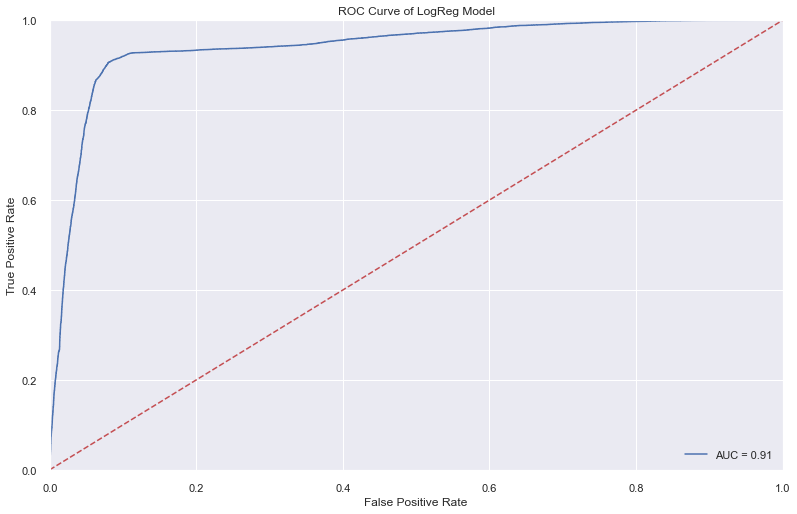

In [64]:
# Predict probability
y_pred_prob = logreg.predict_proba(X_test)[:, 1]
roc_score = roc_auc_score(y_test, y_pred)
print(roc_score)

# Calculate and plot the ROC curve for LogReg method
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
plt.plot(fpr, tpr, label = 'AUC = %0.2f' % roc_score)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.title('ROC Curve of LogReg Model')
plt.show()

[Text(0, 0.5, 'Late'), Text(0, 1.5, 'On Time')]

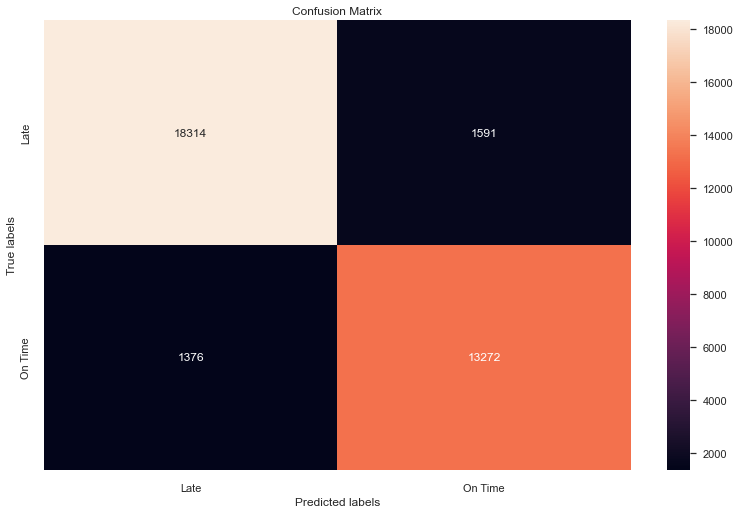

In [65]:
# Confusion Matrix for LogReg method
cm = confusion_matrix(y_test, y_pred)

ax = plt.subplot()
sns.heatmap(cm, annot=True, fmt='g', ax=ax)
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(['Late', 'On Time'])
ax.yaxis.set_ticklabels(['Late', 'On Time'])

In [66]:
# since our objective is to imporve the recall ratio - we will change the threshold to see the impact 
y.value_counts()/len(y)

0    0.576066
1    0.423934
Name: Delivery Timeliness, dtype: float64

[Text(0, 0.5, 'Late'), Text(0, 1.5, 'On Time')]

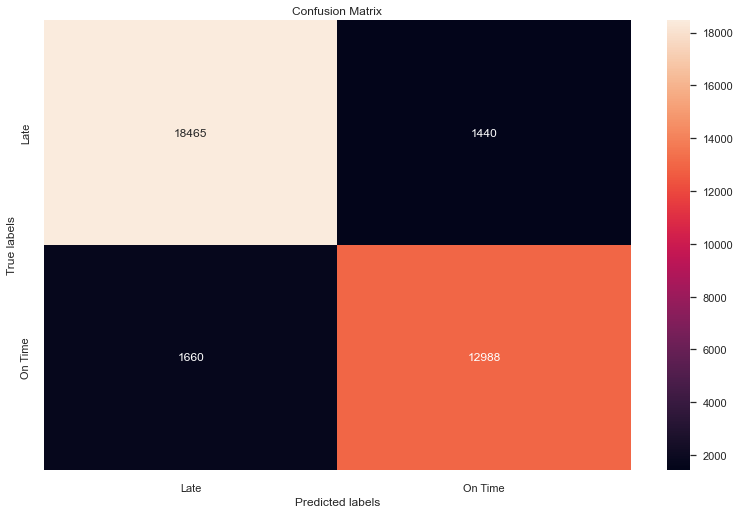

In [67]:
# assuming the threshold of 0.57
y_pred_new = np.where(y_pred_prob >=0.57, 1, 0)

# Confusion Matrix for LogReg method after threshold adjustment
cm = confusion_matrix(y_test, y_pred_new)

ax = plt.subplot()
sns.heatmap(cm, annot=True, fmt='g', ax=ax)
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(['Late', 'On Time'])
ax.yaxis.set_ticklabels(['Late', 'On Time'])

In [68]:
#We improved the recall ratio but the percision is lower 
print(classification_report(y_test, y_pred_new))

              precision    recall  f1-score   support

           0       0.92      0.93      0.92     19905
           1       0.90      0.89      0.89     14648

    accuracy                           0.91     34553
   macro avg       0.91      0.91      0.91     34553
weighted avg       0.91      0.91      0.91     34553



<a id="sectionfive-subtwo"></a>
## 5.2 K Neighbors Classifier Method

In [120]:
'''
# Uncomment to retrain model
# Setup the pipeline steps: steps
steps2 = [('scaler', StandardScaler()),
         ('k_neighbors', KNeighborsClassifier())]

# Create the pipeline: pipeline 
pipeline2 = Pipeline(steps2)

# Specify the hyperparameter space
param_grid = {'k_neighbors__n_neighbors':np.arange(10, 20)}

# Create the GridSearchCV object: knn
knn_cv = GridSearchCV(pipeline2,param_grid,n_jobs=4,verbose=2,cv=5)

# Fit to the training set
knn_cv.fit(X_train,y_train)
'''

Fitting 5 folds for each of 10 candidates, totalling 50 fits


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('k_neighbors',
                                        KNeighborsClassifier())]),
             n_jobs=4,
             param_grid={'k_neighbors__n_neighbors': array([10, 11, 12, 13, 14, 15, 16, 17, 18, 19])},
             verbose=2)

In [121]:
'''
# Uncomment to retrain model
# save best kNN model to disk
filename_knn = 'finalized_kNN_model.sav'
joblib.dump(knn_cv, filename_knn)
'''

['finalized_kNN_model.sav']

In [122]:
# load best kNN model from disk
filename_knn = 'finalized_kNN_model.sav'
knn_cv = joblib.load(filename_knn)

In [123]:
# Compute and print the metrics
print('Best Score: %s' % knn_cv.best_score_)
print('Best Hyperparameters: %s' % knn_cv.best_params_)

Best Score: 0.9023818458412659
Best Hyperparameters: {'k_neighbors__n_neighbors': 17}


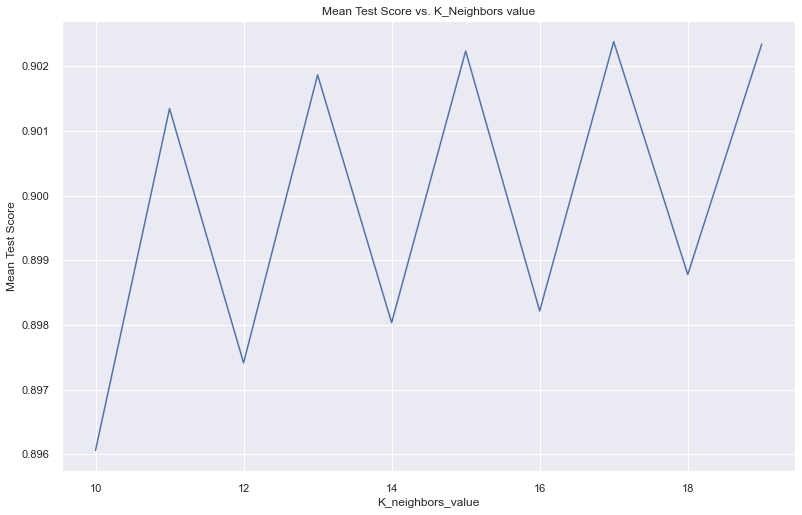

In [124]:
# Plot the mean_test_score values (after 5-fold CV) versus k_neighbors from 10 to 20 curve
x1 = np.arange(10, 20)
y1 = knn_cv.cv_results_['mean_test_score']
plt.plot(x1,y1)
plt.xlabel('K_neighbors_value')
plt.ylabel('Mean Test Score')
plt.title('Mean Test Score vs. K_Neighbors value')
plt.show()

In [125]:
# Run the model using the best paramter
#knn = KNeighborsClassifier(n_neighbors=knn_cv.best_params_['k_neighbors__n_neighbors'])
knn = knn_cv.best_estimator_

#Make the prediction:
y_pred1 = knn.predict (X_test)

#Classification report
print (classification_report(y_test, y_pred1))

              precision    recall  f1-score   support

           0       0.90      0.94      0.92     19905
           1       0.91      0.86      0.88     14648

    accuracy                           0.90     34553
   macro avg       0.91      0.90      0.90     34553
weighted avg       0.91      0.90      0.90     34553



0.8984851258250035


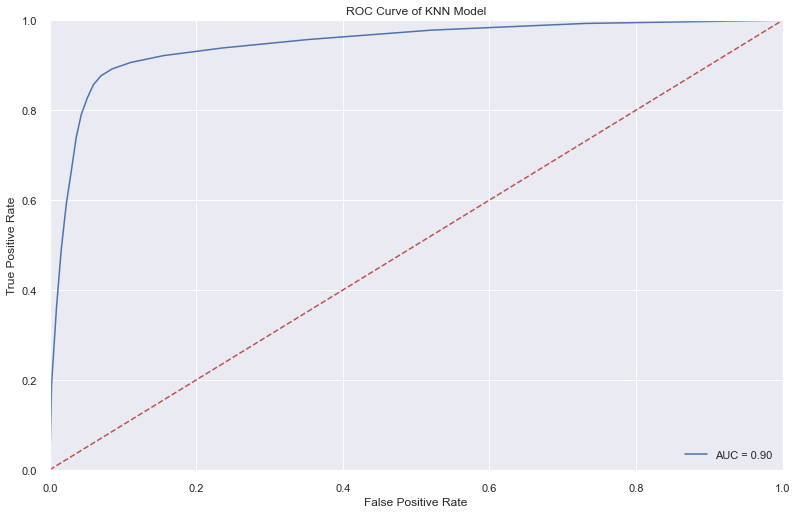

In [126]:
# Compute predicted probabilities: y_pred_prob
y_pred_prob1 = knn.predict_proba(X_test)[:,1]
roc_score1 = roc_auc_score(y_test, y_pred1)
print(roc_score1)

# Calculate and plot the ROC curve for KNN method
fpr1, tpr1, thresholds1 = roc_curve(y_test, y_pred_prob1)
plt.plot(fpr1, tpr1, label = 'AUC = %0.2f' % roc_score1)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1], 'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of KNN Model')
plt.show()

[Text(0, 0.5, 'Late'), Text(0, 1.5, 'On Time')]

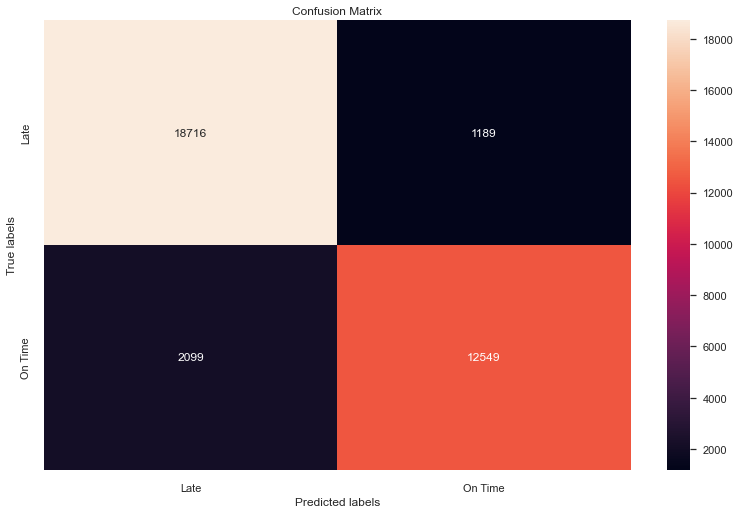

In [127]:
# Confusion Matrix for KNN method
cm1 = confusion_matrix(y_test, y_pred1)
ax = plt.subplot()
sns.heatmap(cm1, annot=True, fmt='g', ax=ax)
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(['Late', 'On Time'])
ax.yaxis.set_ticklabels(['Late', 'On Time'])

[Text(0, 0.5, 'Late'), Text(0, 1.5, 'On Time')]

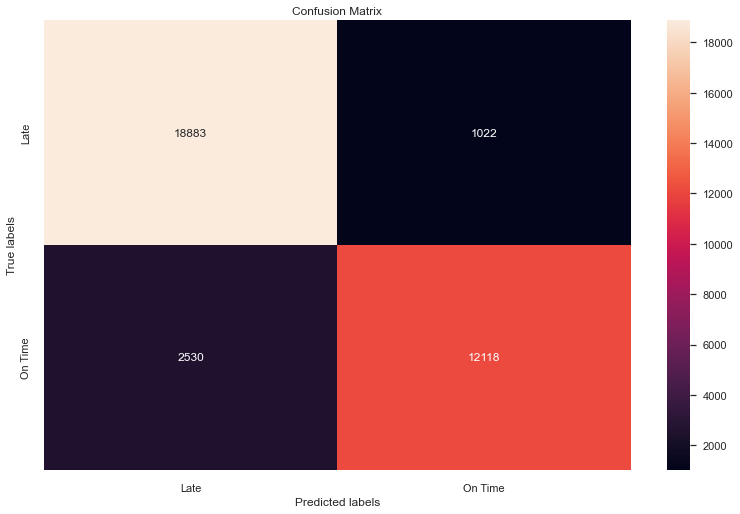

In [128]:
# assuming the threshold of 0.57
y_pred_new1 = np.where(y_pred_prob1 >=0.57, 1, 0)

# Confusion Matrix for Decision Tree after threshold adjustment
cm1 = confusion_matrix(y_test, y_pred_new1)

ax = plt.subplot()
sns.heatmap(cm1, annot=True, fmt='g', ax=ax)
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(['Late', 'On Time'])
ax.yaxis.set_ticklabels(['Late', 'On Time'])

In [129]:
#We improved the recall ratio but the percision is lower 
print(classification_report(y_test, y_pred_new1))

              precision    recall  f1-score   support

           0       0.88      0.95      0.91     19905
           1       0.92      0.83      0.87     14648

    accuracy                           0.90     34553
   macro avg       0.90      0.89      0.89     34553
weighted avg       0.90      0.90      0.90     34553



<a id="sectionfive-subthree"></a>
## 5.3 Supported Vector Machine Method

In [87]:
'''
# Uncomment to retrain model
# Specify the hyperparameter space
param_grid = dict(baggingclassifier__base_estimator__C=[0.001, 0.01, 0.1],
                  baggingclassifier__base_estimator__class_weight=[None, 'balanced'])

# Create the GridSearchCV object: svm
svm_cv = GridSearchCV(make_pipeline(StandardScaler(),\
                                    BaggingClassifier(SVC(kernel = 'linear', cache_size=2000),\
                                                      n_jobs=-1, verbose=2, bootstrap=False, n_estimators=100, max_features=0.5, max_samples=0.05))\
                      , param_grid, refit=True, verbose=2, n_jobs=-1, cv=5)

# Fit to the training set
svm_cv.fit(X_train,y_train)
'''

"\n# Uncomment to retrain model\n# Specify the hyperparameter space\nparam_grid = dict(baggingclassifier__base_estimator__C=[0.001, 0.01, 0.1],\n                  baggingclassifier__base_estimator__class_weight=[None, 'balanced'])\n\n# Create the GridSearchCV object: svm\nsvm_cv = GridSearchCV(make_pipeline(StandardScaler(),                                    BaggingClassifier(SVC(kernel = 'linear', cache_size=2000),                                                      n_jobs=-1, verbose=2, bootstrap=False, n_estimators=100, max_features=0.5, max_samples=0.05))                      , param_grid, refit=True, verbose=2, n_jobs=-1, cv=5)\n\n# Fit to the training set\nsvm_cv.fit(X_train,y_train)\n"

In [88]:
'''
# Uncomment to retrain model
# save best svm model to disk
filename_svm = 'finalized_svm_model.sav'
joblib.dump(svm_cv, filename_svm)
'''

"\n# Uncomment to retrain model\n# save best svm model to disk\nfilename_svm = 'finalized_svm_model.sav'\njoblib.dump(svm_cv, filename_svm)\n"

In [89]:
# load best svm model from disk
filename_svm = 'finalized_svm_model.sav'
svm_cv = joblib.load(filename_svm)

In [90]:
# Compute and print the metrics
print('Best Score: %s' % svm_cv.best_score_)
print('Best Hyperparameters: %s' % svm_cv.best_params_)

Best Score: 0.9038216806281391
Best Hyperparameters: {'baggingclassifier__base_estimator__C': 0.01, 'baggingclassifier__base_estimator__class_weight': 'balanced'}


In [91]:
svm = svm_cv.best_estimator_

#Make the prediction:
y_pred2 = svm.predict (X_test)

#Classification report
print (classification_report(y_test, y_pred2))

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   3 out of  16 | elapsed:   27.0s remaining:  2.0min
[Parallel(n_jobs=16)]: Done  12 out of  16 | elapsed:   30.7s remaining:   10.2s


              precision    recall  f1-score   support

           0       0.90      0.94      0.92     19905
           1       0.91      0.86      0.88     14648

    accuracy                           0.90     34553
   macro avg       0.91      0.90      0.90     34553
weighted avg       0.90      0.90      0.90     34553



[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:   33.6s finished


[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   3 out of  16 | elapsed:   25.9s remaining:  1.9min
[Parallel(n_jobs=16)]: Done  12 out of  16 | elapsed:   29.9s remaining:    9.9s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:   32.7s finished


0.8986196534165358


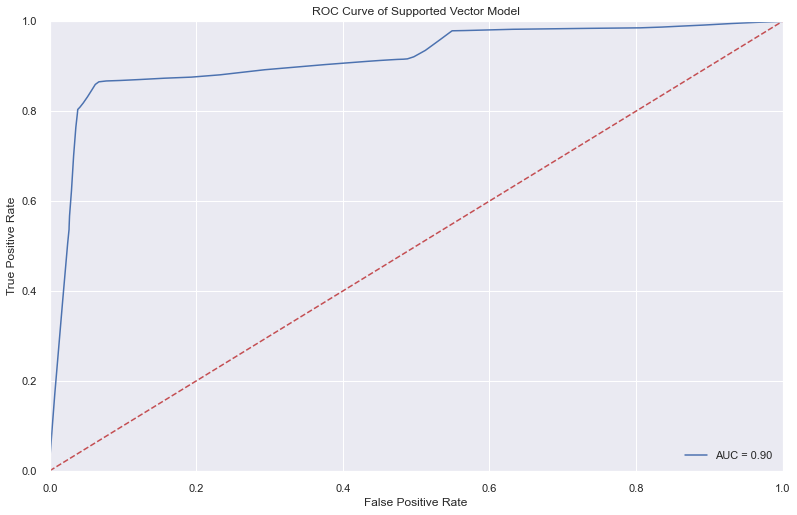

In [92]:
# Predict probability based on predict_proba
y_pred_prob2 = svm.predict_proba(X_test)[:, 1]
roc_score2 = roc_auc_score(y_test, y_pred2)
print(roc_score2)

# Calculate and plot the ROC curve for SVM method
fpr2, tpr2, thresholds2 = roc_curve(y_test, y_pred_prob2)
plt.plot(fpr2, tpr2, label = 'AUC = %0.2f' % roc_score2)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.title('ROC Curve of Supported Vector Model')
plt.show()

[Text(0, 0.5, 'Late'), Text(0, 1.5, 'On Time')]

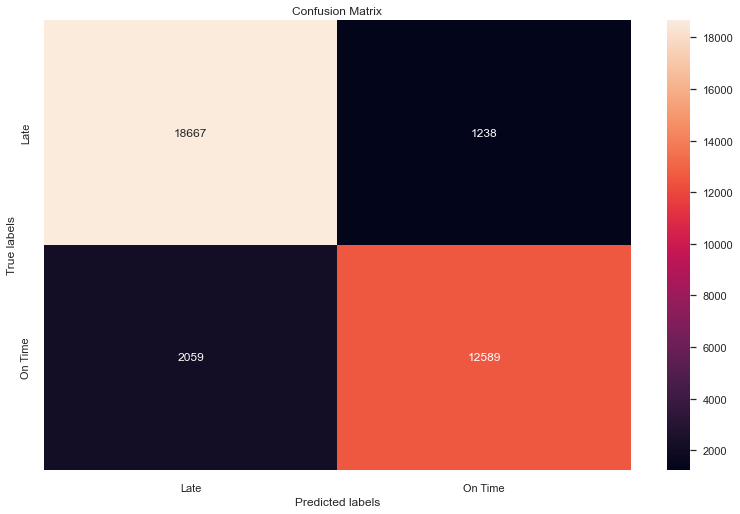

In [93]:
# Confusion Matrix for SVM
cm2 = confusion_matrix(y_test, y_pred2)
ax = plt.subplot()
sns.heatmap(cm2, annot=True, fmt='g', ax=ax)
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(['Late', 'On Time'])
ax.yaxis.set_ticklabels(['Late', 'On Time'])

In [94]:
thresholds2.shape

(61,)

[Text(0, 0.5, 'Late'), Text(0, 1.5, 'On Time')]

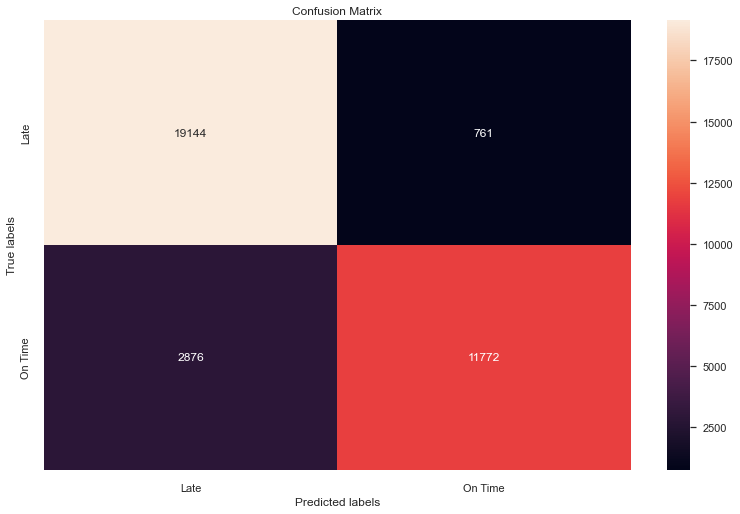

In [95]:
# assuming the threshold of 0.57
y_pred_new2 = np.where(y_pred_prob2 >=0.57, 1, 0)

# Confusion Matrix for SVM after threshold adjustment
cm2 = confusion_matrix(y_test, y_pred_new2)

ax = plt.subplot()
sns.heatmap(cm2, annot=True, fmt='g', ax=ax)
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(['Late', 'On Time'])
ax.yaxis.set_ticklabels(['Late', 'On Time'])

In [96]:
#We improved the recall ratio but the percision is lower 
print(classification_report(y_test, y_pred_new2))

              precision    recall  f1-score   support

           0       0.87      0.96      0.91     19905
           1       0.94      0.80      0.87     14648

    accuracy                           0.89     34553
   macro avg       0.90      0.88      0.89     34553
weighted avg       0.90      0.89      0.89     34553



<a id="sectionfive-subfour"></a>
## 5.4 Decision Tree Classifier Method

In [97]:
'''
# Uncomment to retrain model
# Specify the hyperparameters
param_grid = {'max_depth': range(1,10)}#, 'min_samples_leaf':[1,2,3]}

# Create the DecisionTreeClassifier : dt
dt = DecisionTreeClassifier()

# Create the GridSearchCV object: dt_cv
dt_cv = GridSearchCV(dt,param_grid,cv=5,return_train_score = True)

# Fit to the training set
dt_cv.fit(X_train,y_train)
'''

"\n# Uncomment to retrain model\n# Specify the hyperparameters\nparam_grid = {'max_depth': range(1,10)}#, 'min_samples_leaf':[1,2,3]}\n\n# Create the DecisionTreeClassifier : dt\ndt = DecisionTreeClassifier()\n\n# Create the GridSearchCV object: dt_cv\ndt_cv = GridSearchCV(dt,param_grid,cv=5,return_train_score = True)\n\n# Fit to the training set\ndt_cv.fit(X_train,y_train)\n"

In [98]:
'''
# Uncomment to retrain model
# save best decision tree model to disk
filename_dt = 'finalized_dt_model.sav'
joblib.dump(dt_cv, filename_dt)
'''

"\n# Uncomment to retrain model\n# save best decision tree model to disk\nfilename_dt = 'finalized_dt_model.sav'\njoblib.dump(dt_cv, filename_dt)\n"

In [99]:
# load best decision tree model from disk
filename_dt = 'finalized_dt_model.sav'
dt_cv = joblib.load(filename_dt)

In [100]:
# Compute and print the metrics
print('Best Score: %s' % dt_cv.best_score_)
print('Best Hyperparameters: %s' % dt_cv.best_params_)

Best Score: 0.9144068550452683
Best Hyperparameters: {'max_depth': 6}


In [101]:
dt = dt_cv.best_estimator_

#Make the prediction:
y_pred3 = dt.predict (X_test)

#Classification report
print (classification_report(y_test, y_pred3))

              precision    recall  f1-score   support

           0       0.93      0.93      0.93     19905
           1       0.90      0.90      0.90     14648

    accuracy                           0.92     34553
   macro avg       0.91      0.91      0.91     34553
weighted avg       0.92      0.92      0.92     34553



0.9131147784719087


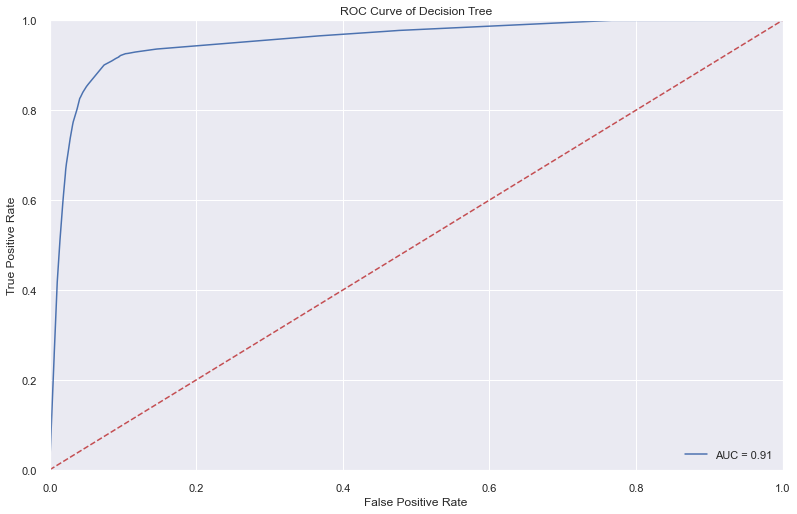

In [102]:
# Compute predicted probabilities: y_pred_prob
y_pred_prob3 = dt_cv.predict_proba(X_test)[:,1]
roc_score3 = roc_auc_score(y_test, y_pred3)
print(roc_score3)

# Calculate and plot the ROC curve for Decision Tree
fpr3, tpr3, thresholds3 = roc_curve(y_test, y_pred_prob3)
plt.plot(fpr3, tpr3,label = 'AUC = %0.2f' % roc_score3)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1], 'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of Decision Tree')
plt.show()

[Text(0, 0.5, 'Late'), Text(0, 1.5, 'On Time')]

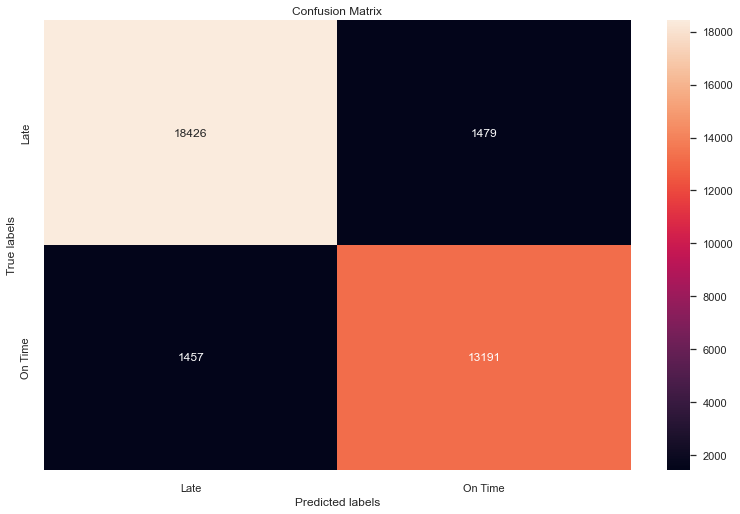

In [103]:
# Confusion Matrix for Decision Tree
cm3 = confusion_matrix(y_test, y_pred3)
ax = plt.subplot()
sns.heatmap(cm3, annot=True, fmt='g', ax=ax)
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(['Late', 'On Time'])
ax.yaxis.set_ticklabels(['Late', 'On Time'])

[Text(0, 0.5, 'Late'), Text(0, 1.5, 'On Time')]

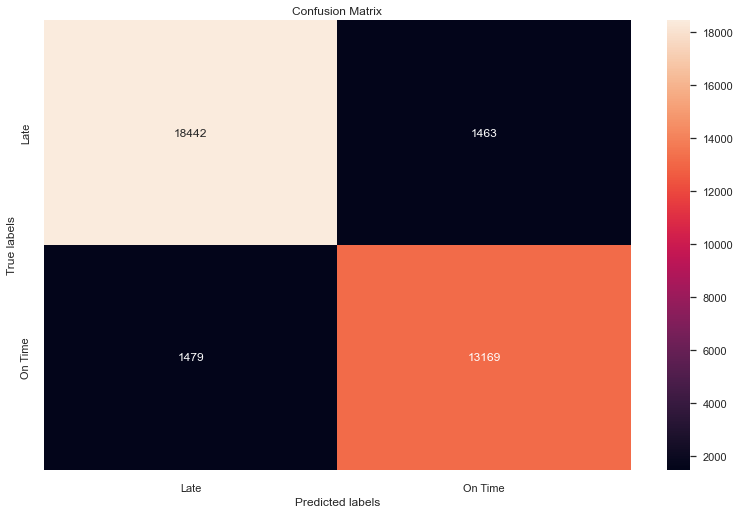

In [104]:
# assuming the threshold of 0.57
y_pred_new3 = np.where(y_pred_prob3 >=0.57, 1, 0)

# Confusion Matrix for Decision Tree after threshold adjustment
cm3 = confusion_matrix(y_test, y_pred_new3)

ax = plt.subplot()
sns.heatmap(cm3, annot=True, fmt='g', ax=ax)
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(['Late', 'On Time'])
ax.yaxis.set_ticklabels(['Late', 'On Time'])

In [105]:
#We improved the recall ratio but the percision is lower 
print(classification_report(y_test, y_pred_new3))

              precision    recall  f1-score   support

           0       0.93      0.93      0.93     19905
           1       0.90      0.90      0.90     14648

    accuracy                           0.91     34553
   macro avg       0.91      0.91      0.91     34553
weighted avg       0.91      0.91      0.91     34553



Type                                                0.002425
Days for shipment (scheduled)                       0.020634
Delivery Status                                     0.950493
Category Name                                       0.000739
Customer City                                       0.000001
Customer Country                                    0.001873
Customer State                                      0.000198
Department Name                                     0.000848
Market                                              0.001176
Order City                                          0.000103
Order Country                                       0.000011
Order Item Quantity                                 0.000000
Order Region                                        0.000000
Order State                                         0.000192
Order Status                                        0.002477
Product Name                                        0.001856
Shipping Mode           

<AxesSubplot:>

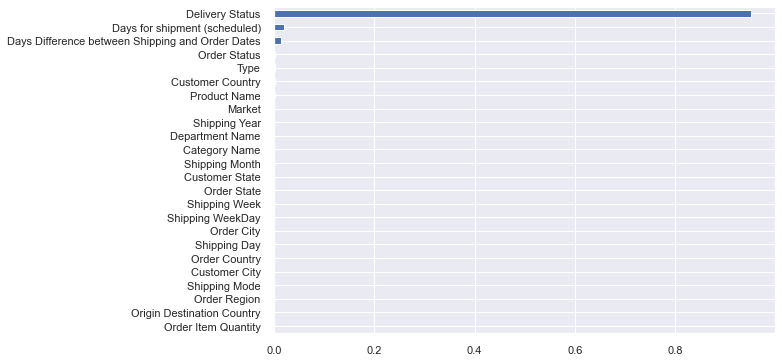

In [106]:
# plot feature importance for Decision Tree
feature_importances_data = pd.Series(dt.feature_importances_, index=X.columns)
print (feature_importances_data)
feature_importances_data.sort_values(ascending=True).plot.barh(figsize=(8,6))

In [107]:
'''
# plot Decision Tree
fig, ax = plt.subplots(figsize=(2,2), dpi=800)
tree.plot_tree(dt, feature_names=X.columns, class_names=y.map({0:"Late", 1:"On Time"}), filled=True, max_depth=3)
fig.savefig('plottreefncn.png')
'''

'\n# plot Decision Tree\nfig, ax = plt.subplots(figsize=(2,2), dpi=800)\ntree.plot_tree(dt, feature_names=X.columns, class_names=y.map({0:"Late", 1:"On Time"}), filled=True, max_depth=3)\nfig.savefig(\'plottreefncn.png\')\n'

<a id="sectionfive-subfive"></a>
## 5.5 Random Forest Classifier Method

In [108]:
'''
# Uncomment to retrain model
# Specify the hyperparameters
param_grid = {'max_depth': range(1,10)}#, 'min_samples_leaf':[1,2,3]}

# Create the RandomForestClassifier : rf
rf = RandomForestClassifier()

# Create the GridSearchCV object: rf_cv
rf_cv = GridSearchCV(rf,param_grid,cv=5,return_train_score = True)

# Fit to the training set
rf_cv.fit(X_train,y_train)
'''

"\n# Uncomment to retrain model\n# Specify the hyperparameters\nparam_grid = {'max_depth': range(1,10)}#, 'min_samples_leaf':[1,2,3]}\n\n# Create the RandomForestClassifier : rf\nrf = RandomForestClassifier()\n\n# Create the GridSearchCV object: rf_cv\nrf_cv = GridSearchCV(rf,param_grid,cv=5,return_train_score = True)\n\n# Fit to the training set\nrf_cv.fit(X_train,y_train)\n"

In [109]:
'''
# Uncomment to retrain model
# save best random forest model to disk
filename_rf = 'finalized_rf_model.sav'
joblib.dump(rf_cv, filename_rf)
'''

"\n# Uncomment to retrain model\n# save best random forest model to disk\nfilename_rf = 'finalized_rf_model.sav'\njoblib.dump(rf_cv, filename_rf)\n"

In [110]:
# load best random forest model from disk
filename_rf = 'finalized_rf_model.sav'
rf_cv = joblib.load(filename_rf)

In [111]:
# Compute and print the metrics
print('Best Score: %s' % rf_cv.best_score_)
print('Best Hyperparameters: %s' % rf_cv.best_params_)

Best Score: 0.9149494991548351
Best Hyperparameters: {'max_depth': 9}


In [112]:
rf = rf_cv.best_estimator_

#Make the prediction:
y_pred4 = rf.predict (X_test)

#Classification report
print (classification_report(y_test, y_pred4))

              precision    recall  f1-score   support

           0       0.93      0.92      0.93     19905
           1       0.90      0.90      0.90     14648

    accuracy                           0.92     34553
   macro avg       0.91      0.91      0.91     34553
weighted avg       0.92      0.92      0.92     34553



0.913899170637261


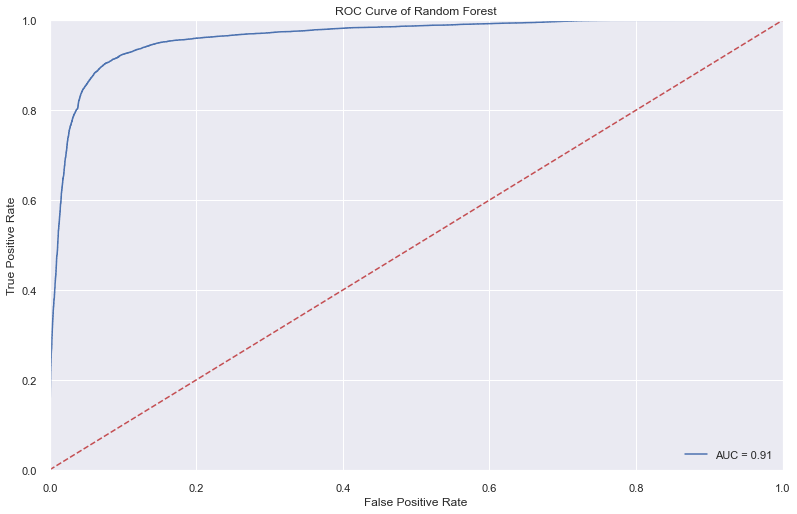

In [113]:
# Compute predicted probabilities: y_pred_prob
y_pred_prob4 = rf_cv.predict_proba(X_test)[:,1]
roc_score4 = roc_auc_score(y_test, y_pred4)
print(roc_score4)

# Calculate and plot the ROC curve for Decision Tree
fpr4, tpr4, thresholds4 = roc_curve(y_test, y_pred_prob4)
plt.plot(fpr4, tpr4,label = 'AUC = %0.2f' % roc_score4)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1], 'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of Random Forest')
plt.show()

[Text(0, 0.5, 'Late'), Text(0, 1.5, 'On Time')]

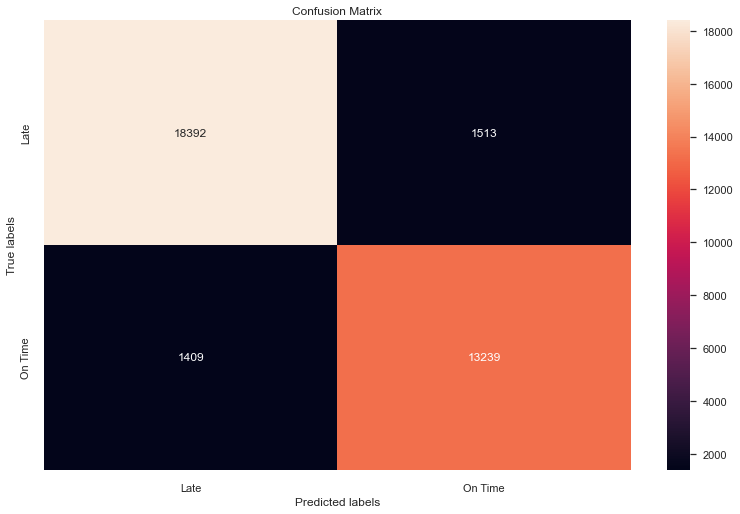

In [114]:
# Confusion Matrix for Random Forest
cm4 = confusion_matrix(y_test, y_pred4)
ax = plt.subplot()
sns.heatmap(cm4, annot=True, fmt='g', ax=ax)
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(['Late', 'On Time'])
ax.yaxis.set_ticklabels(['Late', 'On Time'])

[Text(0, 0.5, 'Late'), Text(0, 1.5, 'On Time')]

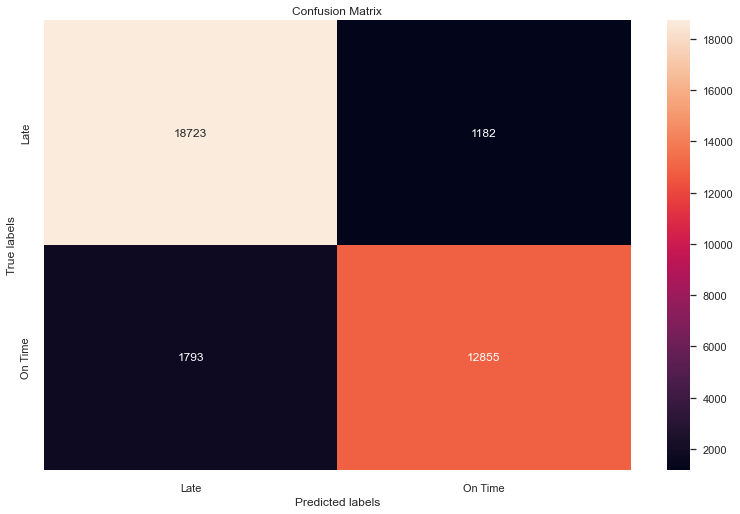

In [115]:
# assuming the threshold of 0.57
y_pred_new4 = np.where(y_pred_prob4 >=0.57, 1, 0)

# Confusion Matrix for Decision Tree after threshold adjustment
cm4 = confusion_matrix(y_test, y_pred_new4)

ax = plt.subplot()
sns.heatmap(cm4, annot=True, fmt='g', ax=ax)
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(['Late', 'On Time'])
ax.yaxis.set_ticklabels(['Late', 'On Time'])

In [116]:
#We improved the recall ratio but the percision is lower 
print(classification_report(y_test, y_pred_new4))

              precision    recall  f1-score   support

           0       0.91      0.94      0.93     19905
           1       0.92      0.88      0.90     14648

    accuracy                           0.91     34553
   macro avg       0.91      0.91      0.91     34553
weighted avg       0.91      0.91      0.91     34553



Type                                                0.002259
Days for shipment (scheduled)                       0.160725
Delivery Status                                     0.381917
Category Name                                       0.002191
Customer City                                       0.002195
Customer Country                                    0.001846
Customer State                                      0.001788
Department Name                                     0.001347
Market                                              0.000858
Order City                                          0.001642
Order Country                                       0.001004
Order Item Quantity                                 0.001267
Order Region                                        0.000824
Order State                                         0.001412
Order Status                                        0.002028
Product Name                                        0.002640
Shipping Mode           

<AxesSubplot:>

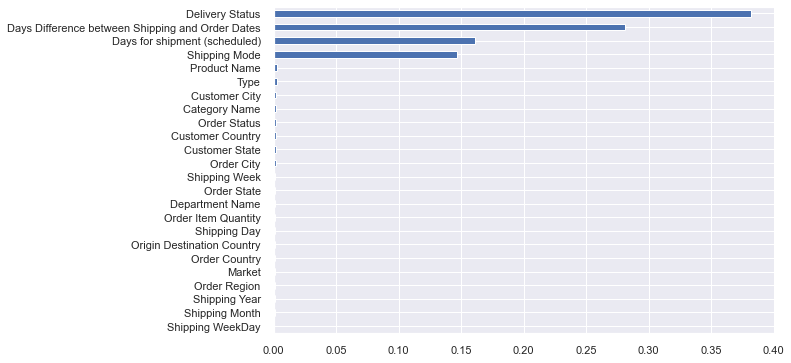

In [117]:
# plot feature importance for Random Forest
feature_importances_data = pd.Series(rf.feature_importances_, index=X.columns)
print (feature_importances_data)
feature_importances_data.sort_values(ascending=True).plot.barh(figsize=(8,6))

In [118]:
# We have 100 estimators ensembled in the random forest
print(len(rf.estimators_))

100


In [119]:
'''
# The code below visualizes the first 5 decision trees from the random forest model fit above. This may not the best way to view each estimator as it is small
fig, axes = plt.subplots(nrows = 1,ncols = 5,figsize = (10,2), dpi=1500)
for index in range(0, 5):
    tree.plot_tree(rf.estimators_[index],
                   feature_names=X.columns,
                   class_names=y.map({0:"Late", 1:"On Time"}),
                   filled = True,
                   ax = axes[index]);
    
    axes[index].set_title('Estimator: ' + str(index), fontsize = 11)
fig.savefig('rf_5trees.png')
'''

'\n# The code below visualizes the first 5 decision trees from the random forest model fit above. This may not the best way to view each estimator as it is small\nfig, axes = plt.subplots(nrows = 1,ncols = 5,figsize = (10,2), dpi=1500)\nfor index in range(0, 5):\n    tree.plot_tree(rf.estimators_[index],\n                   feature_names=X.columns,\n                   class_names=y.map({0:"Late", 1:"On Time"}),\n                   filled = True,\n                   ax = axes[index]);\n    \n    axes[index].set_title(\'Estimator: \' + str(index), fontsize = 11)\nfig.savefig(\'rf_5trees.png\')\n'

<a id="sectionfive-subsix"></a>
## 5.6 Extreme Gradient Boosting Classifier (XGBoost) Method

In [76]:
'''
# Uncomment to retrain model
# Setup the pipeline steps: steps
steps4 = [('scaler', StandardScaler()),
          ('xgb_model', XGBClassifier())]

# Create the pipeline: pipeline 
pipeline4 = Pipeline(steps4)

# Specify the hyperparameters
paramGrid = {
    "xgb_model__colsample_bytree": [0.5,0.75,1],
    "xgb_model__reg_alpha": [0.1,0.5],
    "xgb_model__learning_rate": [0.01,0.1,0.3], # default 0.1 
    "xgb_model__max_depth": range(1,10), # default 3
    "xgb_model__n_estimators": [10,50,100,150], # default 100
    "xgb_model__subsample": [0.5,0.75,1]
}

# Create the GridSearchCV object: xgb_cv
xgb_cv = GridSearchCV(pipeline4, paramGrid, cv=5, verbose=2, n_jobs=-1, refit="roc_auc", scoring="roc_auc", return_train_score=True)

# Fit to the training set
xgb_cv.fit(X_train,y_train)
'''

'\n# Uncomment to retrain model\n# Setup the pipeline steps: steps\nsteps4 = [(\'scaler\', StandardScaler()),\n          (\'xgb_model\', XGBClassifier())]\n\n# Create the pipeline: pipeline \npipeline4 = Pipeline(steps4)\n\n# Specify the hyperparameters\nparamGrid = {\n    "xgb_model__colsample_bytree": [0.5,0.75,1],\n    "xgb_model__reg_alpha": [0.1,0.5],\n    "xgb_model__learning_rate": [0.01,0.1,0.3], # default 0.1 \n    "xgb_model__max_depth": range(1,10), # default 3\n    "xgb_model__n_estimators": [10,50,100,150], # default 100\n    "xgb_model__subsample": [0.5,0.75,1]\n}\n\n# Create the GridSearchCV object: xgb_cv\nxgb_cv = GridSearchCV(pipeline4, paramGrid, cv=5, verbose=2, n_jobs=-1, refit="roc_auc", scoring="roc_auc", return_train_score=True)\n\n# Fit to the training set\nxgb_cv.fit(X_train,y_train)\n'

In [77]:
'''
# Uncomment to retrain model
# save best XGB model to disk
filename_xgb = 'finalized_xgb_model.sav'
joblib.dump(xgb_cv, filename_xgb)
'''

"\n# Uncomment to retrain model\n# save best XGB model to disk\nfilename_xgb = 'finalized_xgb_model.sav'\njoblib.dump(xgb_cv, filename_xgb)\n"

In [78]:
# load best xgb model from disk
filename_xgb = 'finalized_xgb_model.sav'
xgb_cv = joblib.load(filename_xgb)

In [79]:
# Compute and print the metrics
print('Best Score: %s' % xgb_cv.best_score_)
print('Best Hyperparameters: %s' % xgb_cv.best_params_)

Best Score: 0.9726814490384615
Best Hyperparameters: {'xgb_model__colsample_bytree': 0.75, 'xgb_model__learning_rate': 0.1, 'xgb_model__max_depth': 9, 'xgb_model__n_estimators': 100, 'xgb_model__reg_alpha': 0.5, 'xgb_model__subsample': 1}


In [80]:
xgb = xgb_cv.best_estimator_

#Make the prediction:
y_pred5 = xgb.predict (X_test)

#Classification report
print (classification_report(y_test, y_pred5))

              precision    recall  f1-score   support

           0       0.93      0.93      0.93     19905
           1       0.90      0.90      0.90     14648

    accuracy                           0.92     34553
   macro avg       0.92      0.92      0.92     34553
weighted avg       0.92      0.92      0.92     34553



0.9154070275918752


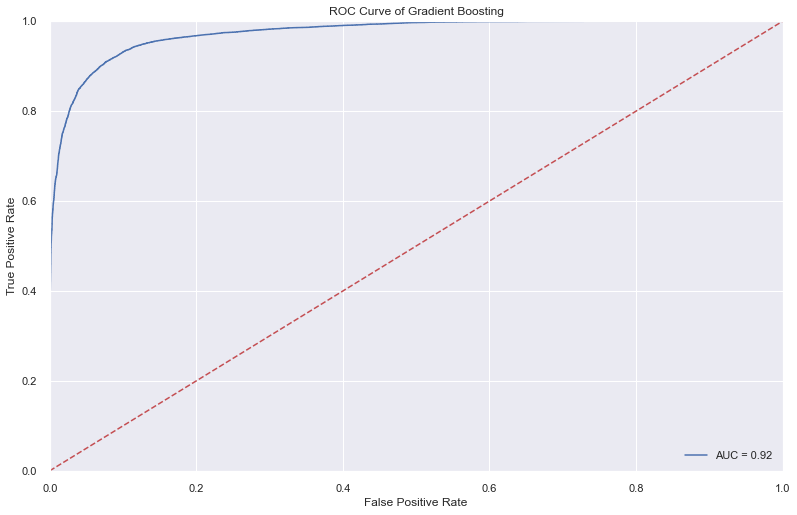

In [81]:
# Compute predicted probabilities: y_pred_prob
y_pred_prob5 = xgb_cv.predict_proba(X_test)[:,1]
roc_score5 = roc_auc_score(y_test, y_pred5)
print(roc_score5)

# Calculate and plot the ROC curve for XGB
fpr5, tpr5, thresholds5 = roc_curve(y_test, y_pred_prob5)
plt.plot(fpr5, tpr5, label = 'AUC = %0.2f' % roc_score5)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1], 'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of Gradient Boosting')
plt.show()

[Text(0, 0.5, 'Late'), Text(0, 1.5, 'On Time')]

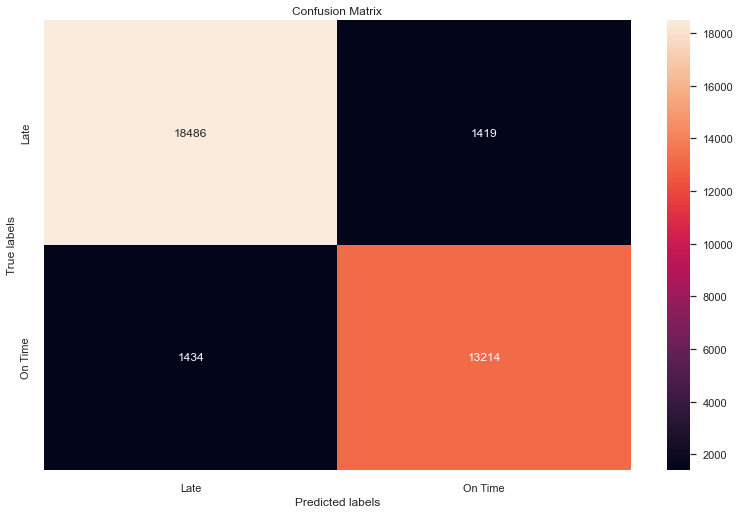

In [82]:
# Confusion Matrix for XGB
cm5 = confusion_matrix(y_test, y_pred5)
ax = plt.subplot()
sns.heatmap(cm5, annot=True, fmt='g', ax=ax)
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(['Late', 'On Time'])
ax.yaxis.set_ticklabels(['Late', 'On Time'])

[Text(0, 0.5, 'Late'), Text(0, 1.5, 'On Time')]

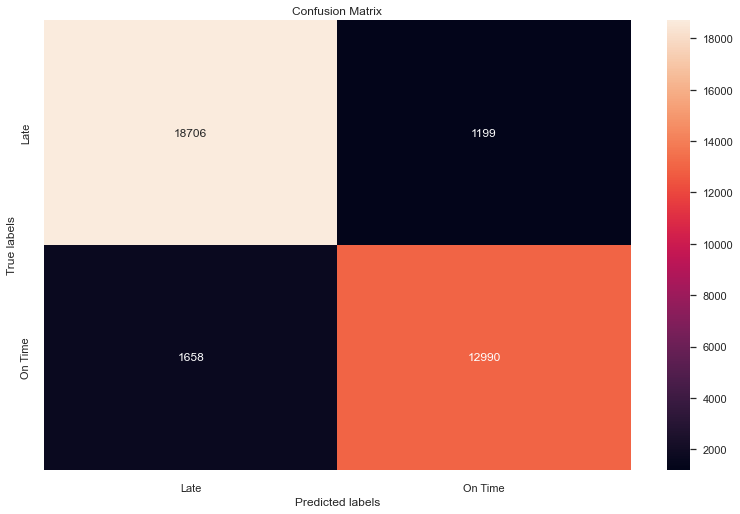

In [83]:
# assuming the threshold of 0.57
y_pred_new5 = np.where(y_pred_prob5 >=0.57, 1, 0)

# Confusion Matrix for XGB after threshold adjustment
cm5 = confusion_matrix(y_test, y_pred_new5)

ax = plt.subplot()
sns.heatmap(cm5, annot=True, fmt='g', ax=ax)
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(['Late', 'On Time'])
ax.yaxis.set_ticklabels(['Late', 'On Time'])

In [84]:
#We improved the recall ratio but the percision is lower 
print(classification_report(y_test, y_pred_new5))

              precision    recall  f1-score   support

           0       0.92      0.94      0.93     19905
           1       0.92      0.89      0.90     14648

    accuracy                           0.92     34553
   macro avg       0.92      0.91      0.91     34553
weighted avg       0.92      0.92      0.92     34553



Type                                                0.003960
Days for shipment (scheduled)                       0.122891
Delivery Status                                     0.646581
Category Name                                       0.002072
Customer City                                       0.001156
Customer Country                                    0.004415
Customer State                                      0.001176
Department Name                                     0.001758
Market                                              0.002403
Order City                                          0.001000
Order Country                                       0.000947
Order Item Quantity                                 0.002058
Order Region                                        0.001089
Order State                                         0.000926
Order Status                                        0.002540
Product Name                                        0.002240
Shipping Mode           

<AxesSubplot:>

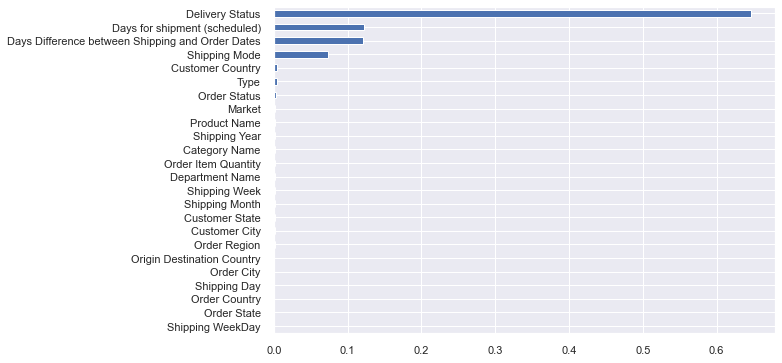

In [85]:
# plot feature importance for XGB model

feature_importances_data = pd.Series(xgb.named_steps["xgb_model"].feature_importances_, index=X.columns)
print (feature_importances_data)
feature_importances_data.sort_values(ascending=True).plot.barh(figsize=(8,6))

In [86]:
'''
# plot XGB best model tree, and save to local
plot_tree(xgb.named_steps["xgb_model"], num_trees=xgb.named_steps["xgb_model"].best_iteration, rankdir='LR')
fig = plt.gcf()
fig.set_size_inches(150, 100)
fig.savefig('plotxgbtreefncn.png')
'''

'\n# plot XGB best model tree, and save to local\nplot_tree(xgb.named_steps["xgb_model"], num_trees=xgb.named_steps["xgb_model"].best_iteration, rankdir=\'LR\')\nfig = plt.gcf()\nfig.set_size_inches(150, 100)\nfig.savefig(\'plotxgbtreefncn.png\')\n'

<a id="section-six"></a>
# VI/ ML Models Performance Comparison

In [173]:
# Create 2 lists that contain the optimized model per classification method and classifier model names
classifier_models = [knn, logreg, svm, dt, rf, xgb]
classifier_model_names = ["Nearest Neighbors",
                          "Logistics Regression",
                          "Supported Vector Machine",
                          "Decision Tree",
                          "Random Forest",
                          "Extreme Gradient Boosting"]

### Comparing Models' Performance with ROC Curve Plot

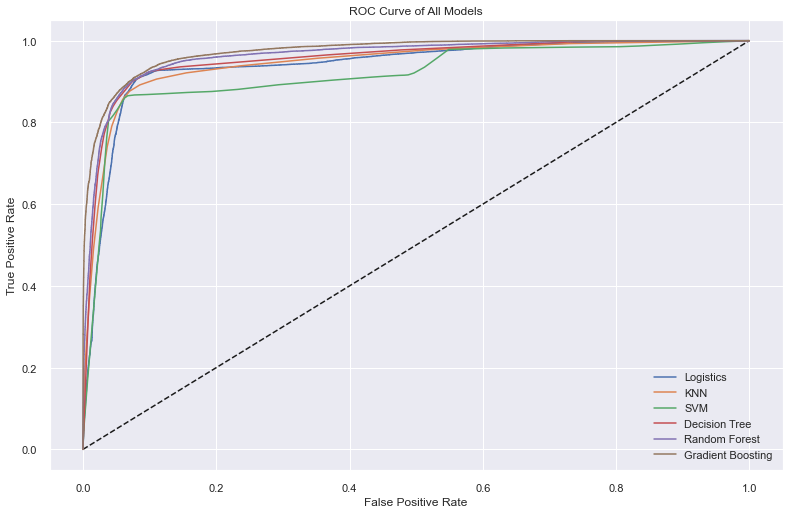

In [155]:
# Plot ROC curve to compare all models
plt.plot([0, 1], [0, 1], 'k--')
plt.plot(fpr, tpr, label='Logistics')
plt.plot(fpr1, tpr1, label='KNN')
plt.plot(fpr2, tpr2, label='SVM')
plt.plot(fpr3, tpr3, label='Decision Tree')
plt.plot(fpr4, tpr4, label='Random Forest')
plt.plot(fpr5, tpr5, label='Gradient Boosting')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of All Models')
plt.legend()
plt.show()

All models seem to perform very close to each other in terms of accuracy of the predictions when viewing from the ROC curve, where the Gradient Boosting model (the brown line) marginally outperforms all others, offers the largest area under the curve with value AUC = 0.92

### Comparing Models' Performance with Precision-Recall Curve Plot

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   3 out of  16 | elapsed:   25.8s remaining:  1.9min
[Parallel(n_jobs=16)]: Done  12 out of  16 | elapsed:   30.1s remaining:   10.0s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:   33.3s finished


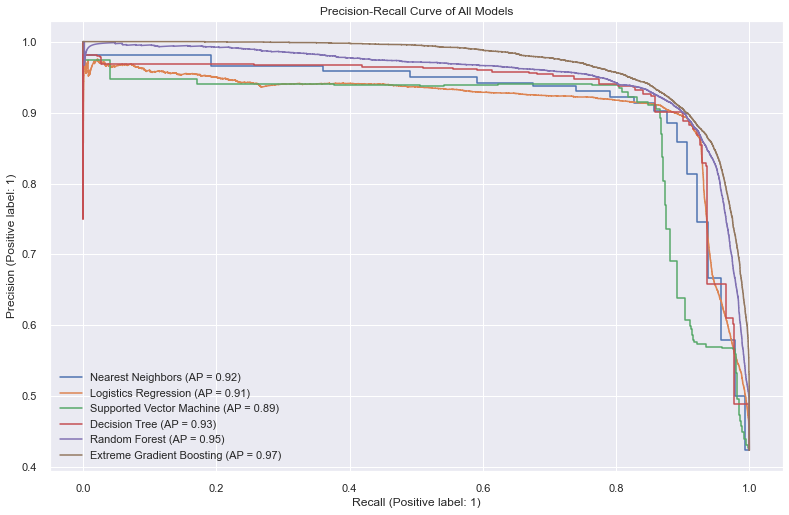

In [181]:
from sklearn.metrics import precision_recall_curve, plot_precision_recall_curve

for clf_name, clf in zip(classifier_model_names, classifier_models):
    plot_precision_recall_curve(clf, X_test, y_test, ax = plt.gca(),name = clf_name)
    plt.title('Precision-Recall Curve of All Models')

According to Scikit-Learn reference, the precision-recall curve shows the tradeoff between precision and recall for different threshold. A high area under the curve represents both high recall and high precision, where high precision relates to a low false positive rate, and high recall relates to a low false negative rate. High scores for both show that the classifier is returning accurate results (high precision), as well as returning a majority of all positive results (high recall).

As can be observed from the plot above, once again XGBoost model is the best performer with AP value of 0.97, with also the smoothest curve which shows its robustness to unseen data

### Detect overfitting among models

In [157]:
training_accuracy = []
testing_accuracy = []

#Compute the train and test accuracy for each model
for model in classifier_models:
    y_pred_train = model.predict(X_train)
    training_accuracy.append(accuracy_score(y_train, y_pred_train))
    Y_pred_test = model.predict(X_test)
    acc_score = accuracy_score(y_test,Y_pred_test)
    testing_accuracy.append(acc_score)

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   3 out of  16 | elapsed:  1.8min remaining:  7.6min
[Parallel(n_jobs=16)]: Done  12 out of  16 | elapsed:  2.0min remaining:   40.9s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:  2.2min finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   3 out of  16 | elapsed:   26.1s remaining:  1.9min
[Parallel(n_jobs=16)]: Done  12 out of  16 | elapsed:   30.2s remaining:   10.0s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:   33.2s finished


In [168]:
train_test_accuracy_benchmark = pd.DataFrame({'models':["KNN", "Logistics Regression", "Supported Vector Machine", "Decision Tree", "Random Forest", "Gradient Boosting"], 'TrainAccuracy':training_accuracy, 'TestAccuracy':testing_accuracy})

train_test_accuracy_benchmark.head()

,models,TrainAccuracy,TestAccuracy
0,KNN,0.911998,0.904842
1,Logistics Regression,0.933812,0.917431
2,Supported Vector Machine,0.914913,0.915029
3,Decision Tree,0.913777,0.914132
4,Random Forest,0.915984,0.915434


In [169]:
train_test_accuracy_benchmark_melted = train_test_accuracy_benchmark.melt(id_vars='models')
train_test_accuracy_benchmark_melted

,models,variable,value
0,KNN,TrainAccuracy,0.911998
1,Logistics Regression,TrainAccuracy,0.933812
2,Supported Vector Machine,TrainAccuracy,0.914913
3,Decision Tree,TrainAccuracy,0.913777
4,Random Forest,TrainAccuracy,0.915984
5,Gradient Boosting,TrainAccuracy,0.902845
6,KNN,TestAccuracy,0.904842
7,Logistics Regression,TestAccuracy,0.917431
8,Supported Vector Machine,TestAccuracy,0.915029
9,Decision Tree,TestAccuracy,0.914132


<AxesSubplot:xlabel='variable', ylabel='value'>

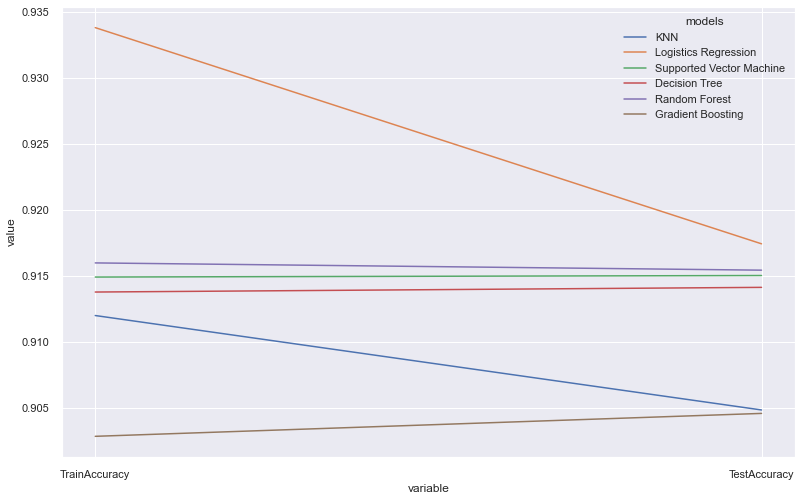

In [170]:
sns.lineplot(x='variable', y='value', hue='models', data=train_test_accuracy_benchmark_melted)

From the graph above, it is apparent that the KNN and Logistics Regression models are overfitted to training data so its test accuracy deteriorates, whereas the Supported Vector Machine, Decision Tree and Random Forest models performance is stable. Only the XGBoost model performs better in hold-out dataset than the training dataset

### Plotting the Decision Surface Boundaries of the constructed Classifier Models

The best site to obtain Python code for plotting decision surfaces can be found on the Sklearn website. There are multiple excellent examples on the site and here are some links that you may find useful:

- Classifier Comparison (https://scikit-learn.org/stable/auto_examples/classification/plot_classifier_comparison.html)

- Plot the Decision Boundaries of a Voting Classifier (https://scikit-learn.org/stable/auto_examples/classification/plot_classifier_comparison.html)

- Plot the decision surface of decision trees trained on the iris dataset (https://scikit-learn.org/stable/auto_examples/tree/plot_iris_dtc.html)

When plotting a decision surface, the general layout of the Python code is as follows:

1) Define an area with which to plot our decision surface and boundaries. We will use a very handy Numpy method meshgrid for this task.

2) Extract either the class probabilities by invoking the attribute "predict_proba" or the distances between boundaries via the attribute "decision_function"

In [171]:
# Plot the dataset and models' predictions
from matplotlib.colors import ListedColormap
from sklearn.gaussian_process.kernels import RBF
#from sklearn.inspection import DecisionBoundaryDisplay

# Instantiate vanila version of classifier models we employed so far
names = [
    "Logistics Regression",
    "Nearest Neighbors",
    "Linear SVM",
    "RBF SVM",
    "Decision Tree",
    "Random Forest",
    "Extreme Gradient Boosting",
]

classifiers = [
    LogisticRegression(C=3),
    KNeighborsClassifier(3),
    SVC(kernel="linear", C=0.025),
    SVC(gamma=2, C=1),
    DecisionTreeClassifier(max_depth=5),
    RandomForestClassifier(max_depth=5, n_estimators=10, max_features=1),
    XGBClassifier(),
]

fig, axes = plt.subplots(nrows = 3,ncols = 8,figsize=(27, 9), dpi=1500)
h = 0.02
i = 1

# Create an illustrated dataset by slicing the clean data frame above with the top 3 features from the scale of feature importance we demonstrated above
for pairidx, pair in enumerate([[1, 2], [1, 18], [2, 18]]): #index as following: 'Days for shipment (scheduled)' (1), 'Delivery Status'(2), 'Days Difference between Shipping and Order Dates' (18)
    # We only take the two corresponding features each loop
    X_illus = df.iloc[:, pair]
    y_illus = df['Delivery Timeliness']
    
    # Apply LabelEncoder method as before
    for col in X_illus:
        X_illus[col] = LabelEncoder().fit_transform(X_illus[col])

    # preprocess dataset, split into training and test part with stratified to adjust for class imbalance
    X_illus = StandardScaler().fit_transform(X_illus)
    X_train_illus, X_test_illus, y_train_illus, y_test_illus = train_test_split(
        X_illus, y_illus, test_size=0.4, random_state=42, stratify=y
    )

    x_min, x_max = X_illus[:, 0].min() - 0.5, X_illus[:, 0].max() + 0.5
    y_min, y_max = X_illus[:, 1].min() - 0.5, X_illus[:, 1].max() + 0.5
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                         np.arange(y_min, y_max, h))

    # just plot the dataset first
    cm = plt.cm.jet
    cm_bright = ListedColormap(["#FF0000", "#0000FF"])
    ax = plt.subplot(len(X_illus), len(classifiers) + 1, i)
    if pairidx == 0:
            ax.set_title("Input data")
    # Plot the training points
    ax.scatter(X_train_illus[:, 0], X_train_illus[:, 1], c=y_train_illus, cmap=cm_bright, edgecolors="k", alpha=0.5)
    # Plot the testing points
    ax.scatter(X_test_illus[:, 0], X_test_illus[:, 1], c=y_test_illus, cmap=cm_bright, alpha=0.5, edgecolors="k")
    ax.set_xlim(xx.min(), xx.max())
    ax.set_ylim(yy.min(), yy.max())
    ax.set_xticks(())
    ax.set_yticks(())
    i += 1

    # iterate over classifiers
    for name, clf in zip(names, classifiers):
        ax = plt.subplot(len(X_illus), len(classifiers) + 1, i)
        clf.fit(X_train_illus, y_train_illus)
        score = clf.score(X_test_illus, y_test_illus)
        
        # Plot the decision boundary. For that, we will assign a color to each
        # point in the mesh [x_min, m_max]x[y_min, y_max].
        if hasattr(clf, "decision_function"):
            Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()])
        else:
            Z = clf.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:, 1]

        # Put the result into a color plot
        Z = Z.reshape(xx.shape)
        ax.contourf(xx, yy, Z, cmap=plt.cm.jet, alpha=0.7)

        # Plot the training points
        ax.scatter(
            X_train_illus[:, 0], X_train_illus[:, 1], c=y_train_illus, cmap=cm_bright, alpha=0.5, linewidths=0.6, edgecolors="white")
        
        # Plot the testing points
        ax.scatter(
            X_test_illus[:, 0],
            X_test_illus[:, 1],
            c=y_test_illus,
            cmap=cm_bright,
            edgecolors="white",
            alpha=0.5,
        )

        ax.set_xlim(xx.min(), xx.max())
        ax.set_ylim(yy.min(), yy.max())
        ax.set_xticks(())
        ax.set_yticks(())
        if pairidx == 0:
            ax.set_title(name)
        ax.text(
            xx.max() - 0.3,
            yy.min() + 0.3,
            ("%.2f" % score).lstrip("0"),
            size=15,
            horizontalalignment="right",
        )
        i += 1

fig.subplots_adjust(left=.02, right=.98)
plt.tight_layout()
plt.show()
fig.savefig('plotdecisionboundary.png')

***Under Development***

In [135]:
best_model = xgb_cv.best_estimator_

calibrated_model = CalibratedClassifierCV(base_estimator=best_model, cv='prefit', n_jobs=-1, ensemble=True)

calibrated_model.fit(X_train,y_train)

CalibratedClassifierCV(base_estimator=Pipeline(steps=[('scaler',
                                                       StandardScaler()),
                                                      ('xgb_model',
                                                       XGBClassifier(base_score=0.5,
                                                                     booster='gbtree',
                                                                     callbacks=None,
                                                                     colsample_bylevel=1,
                                                                     colsample_bynode=1,
                                                                     colsample_bytree=0.75,
                                                                     early_stopping_rounds=None,
                                                                     enable_categorical=False,
                                                                     eval_metric=None,
                                                                     gamma=0,
                                                                     gpu_id=-1,
                                                                     grow_policy='depthwise',
                                                                     importance_type=None,
                                                                     interaction_constraints='',
                                                                     learning_rate=0.1,
                                                                     max_bin=256,
                                                                     max_cat_to_onehot=4,
                                                                     max_delta_step=0,
                                                                     max_depth=9,
                                                                     max_leaves=0,
                                                                     min_child_weight=1,
                                                                     missing=nan,
                                                                     monotone_constraints='()',
                                                                     n_estimators=100,
                                                                     n_jobs=0,
                                                                     num_parallel_tree=1,
                                                                     predictor='auto',
                                                                     random_state=0,
                                                                     reg_alpha=0.5,
                                                                     reg_lambda=1, ...))]),
                       cv='prefit', n_jobs=-1)

[Text(0, 0.5, 'Late'), Text(0, 1.5, 'On Time')]

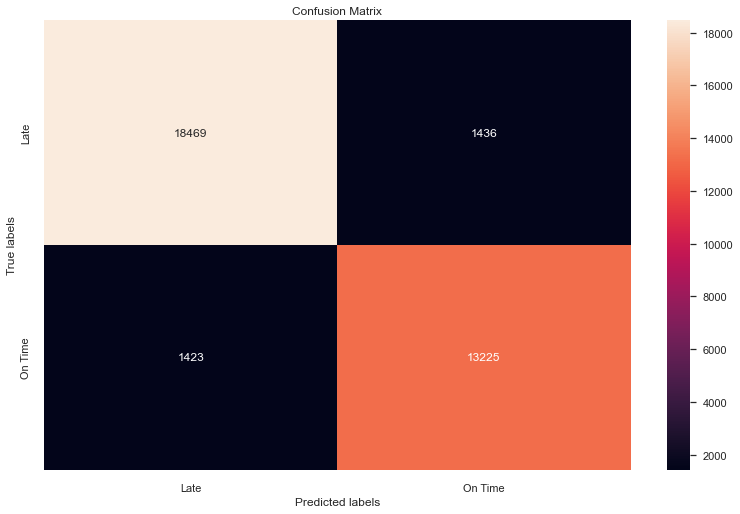

In [136]:
y_pred_cali = calibrated_model.predict(X_test)

cm_cali = confusion_matrix(y_test, y_pred_cali)

ax = plt.subplot()
sns.heatmap(cm_cali, annot=True, fmt='g', ax=ax)
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(['Late', 'On Time'])
ax.yaxis.set_ticklabels(['Late', 'On Time'])